# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [3]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [4]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, critic, and optimizers.

In [5]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [6]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [7]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [8]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = torch.mean((gradient_norm - 1).pow(2))
    #### END CODE HERE ####
    return penalty

In [9]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [14]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = -torch.mean(crit_fake_pred)
    #### END CODE HERE ####
    return gen_loss

In [15]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [18]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = - torch.mean(crit_real_pred) + torch.mean(crit_fake_pred) + gp*c_lambda
    #### END CODE HERE ####
    return crit_loss

In [19]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](MNIST_WGAN_Progression.png)

Step 50: Generator loss: -0.08767375074326993, critic loss: 1.8968880318105221


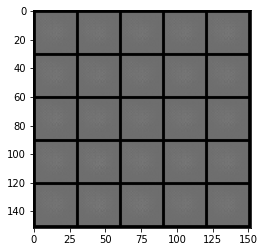

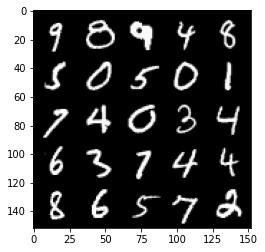

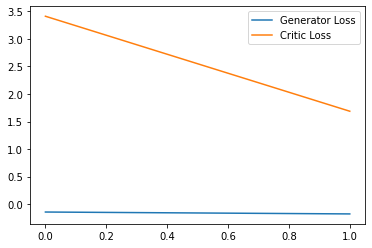

Step 100: Generator loss: 0.7312718088924884, critic loss: -1.599137959390879


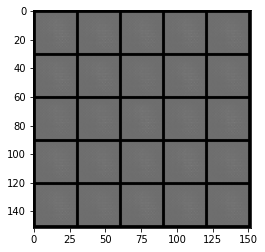

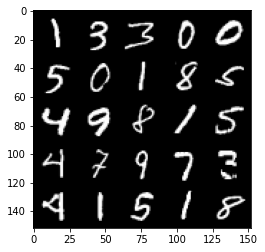

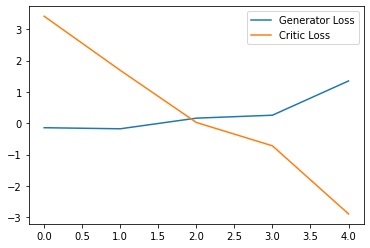

Step 150: Generator loss: 3.318921735286713, critic loss: -10.661368192672729


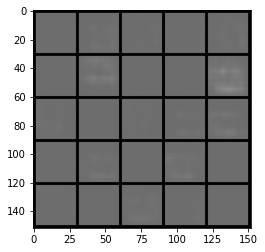

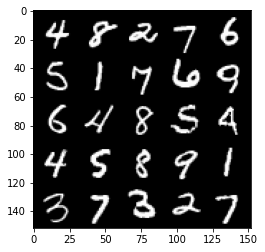

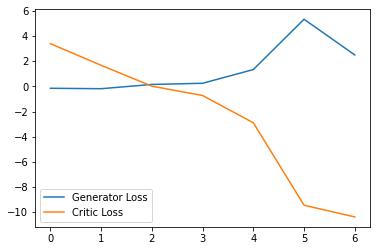

Step 200: Generator loss: -0.1420567250996828, critic loss: -24.00717335128785


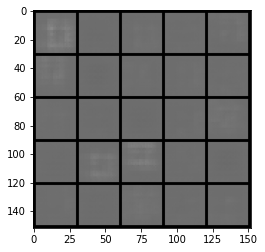

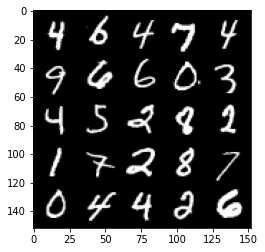

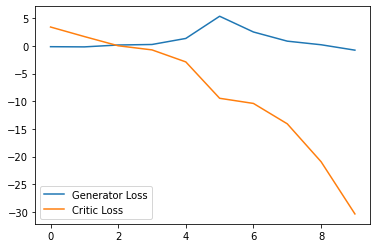

Step 250: Generator loss: -1.8513065838813783, critic loss: -51.77690182495117


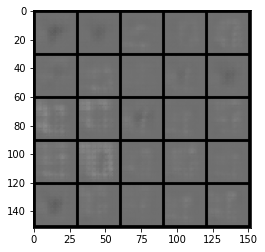

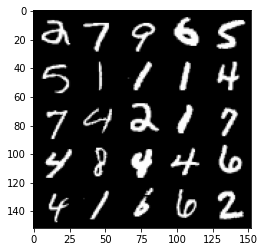

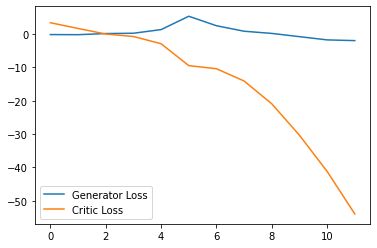

Step 300: Generator loss: 0.1935475267469883, critic loss: -91.34975347900391


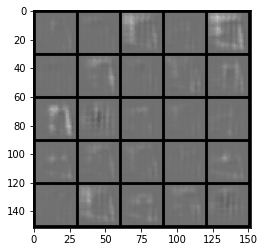

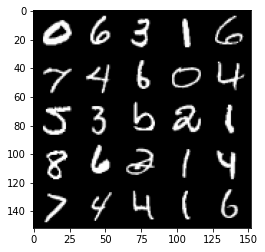

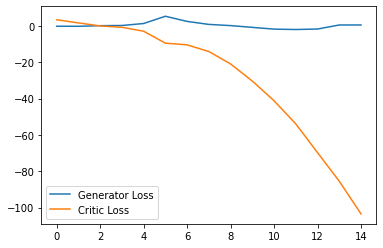

Step 350: Generator loss: 0.8345972162485122, critic loss: -136.06461163330079


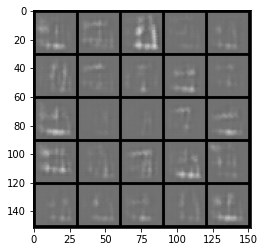

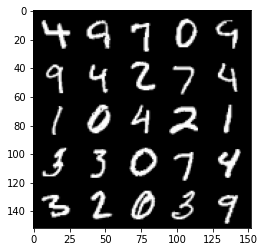

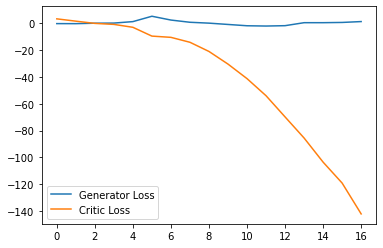

Step 400: Generator loss: -2.195427894592285, critic loss: -176.26018878173835


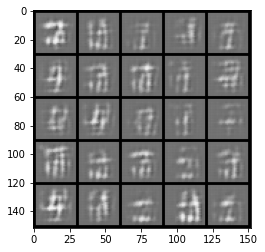

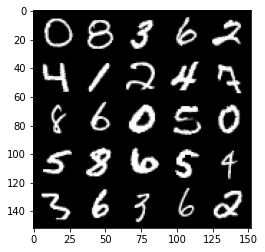

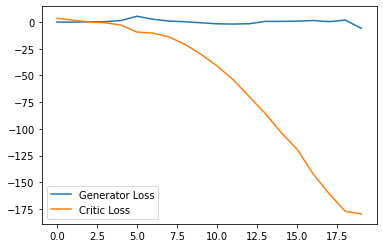

Step 450: Generator loss: -3.1514595115184783, critic loss: -198.25600646972651


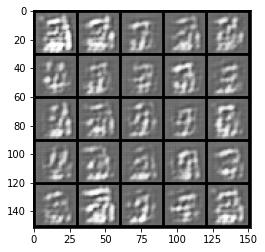

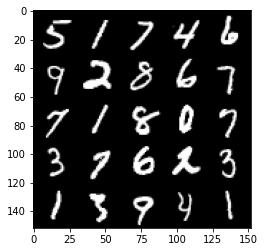

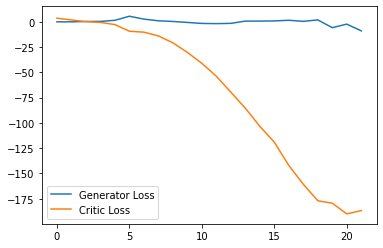

Step 500: Generator loss: -3.0412089213728906, critic loss: -205.55029930114745


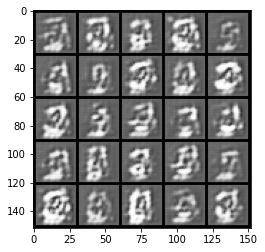

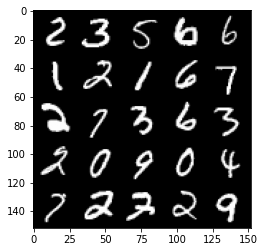

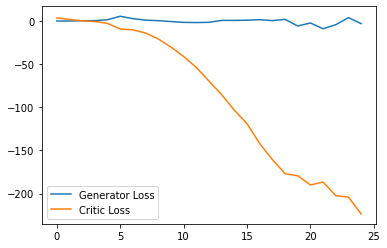

Step 550: Generator loss: -53.090411520004274, critic loss: -156.14563305664063


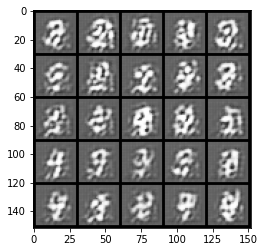

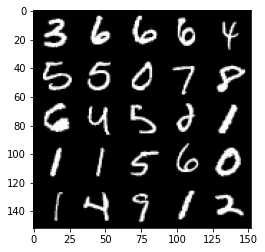

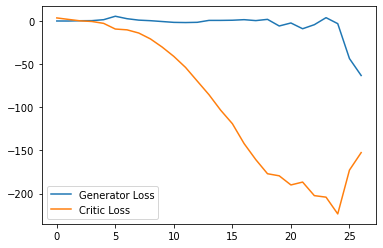

Step 600: Generator loss: -52.86383325099945, critic loss: -151.8830630645752


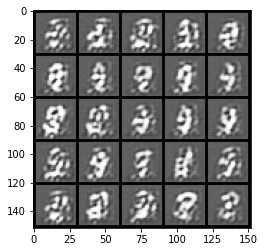

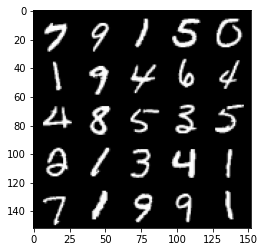

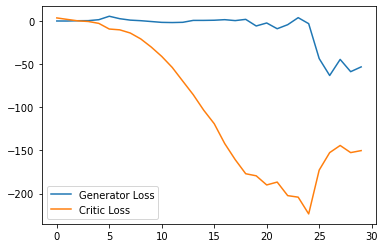

Step 650: Generator loss: -31.968658757209777, critic loss: -190.11872366333012


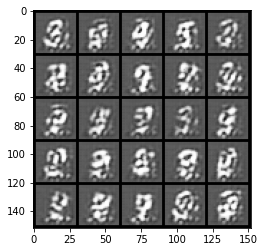

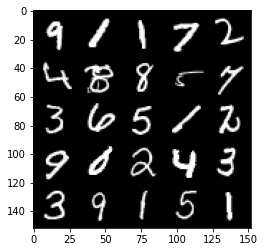

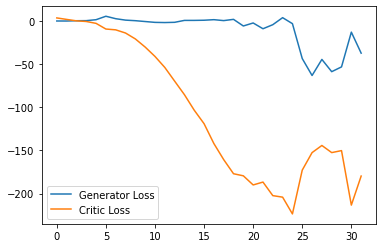

Step 700: Generator loss: -47.431375427246095, critic loss: -172.30578092956546


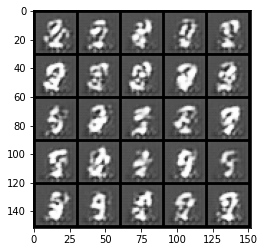

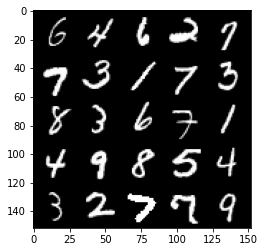

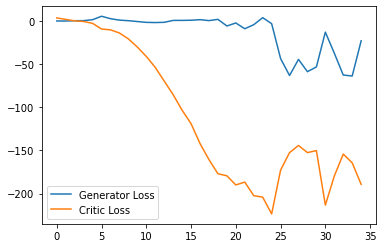

Step 750: Generator loss: -28.93997929096222, critic loss: -148.00654821014408


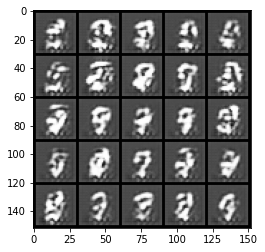

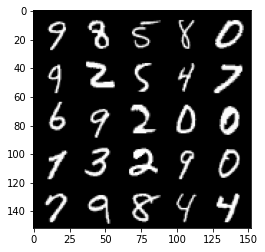

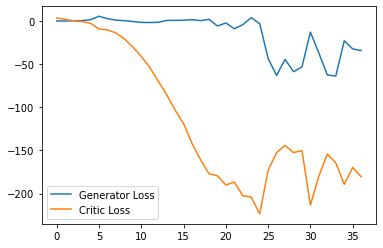

Step 800: Generator loss: -44.76819245815277, critic loss: -100.86831649017331


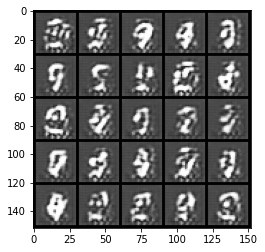

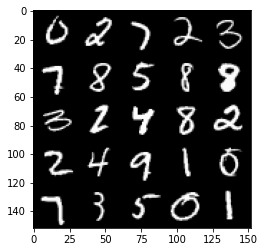

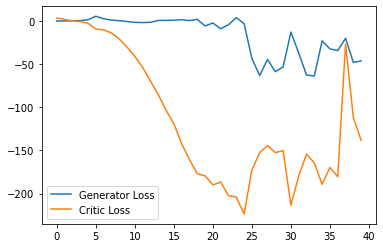

Step 850: Generator loss: -38.01859374046326, critic loss: -145.05233361816406


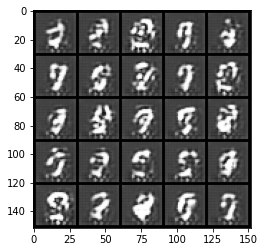

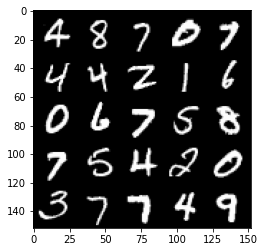

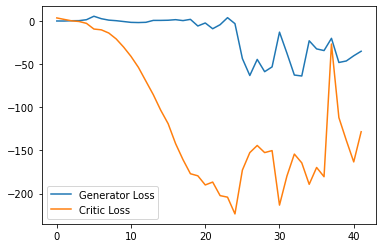

Step 900: Generator loss: -15.155732058882712, critic loss: 3.9569653320312494


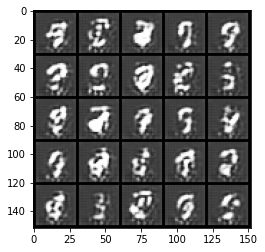

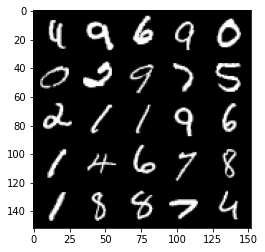

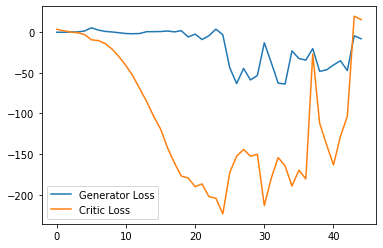

Step 950: Generator loss: -48.814336166381835, critic loss: -82.42072082519532


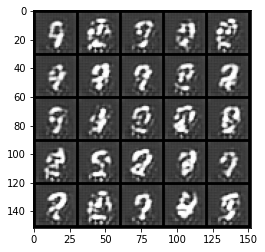

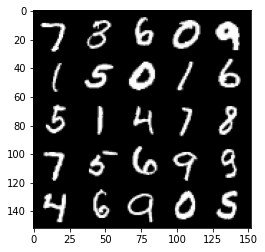

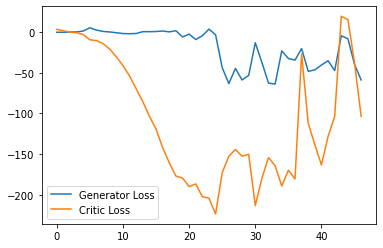

Step 1000: Generator loss: -22.287321767807008, critic loss: -13.37215997314453


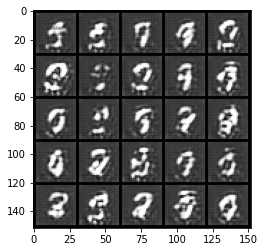

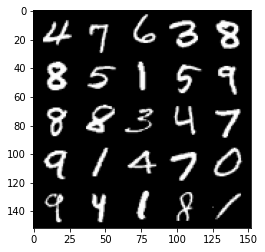

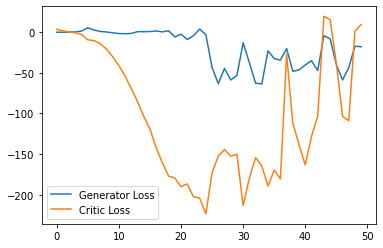

Step 1050: Generator loss: -50.955570678710934, critic loss: -77.73135234832763


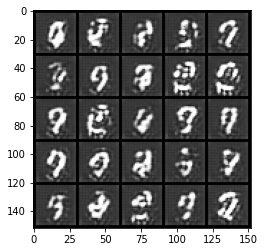

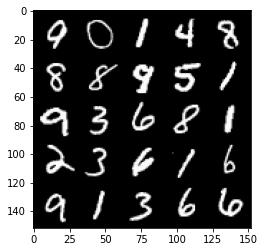

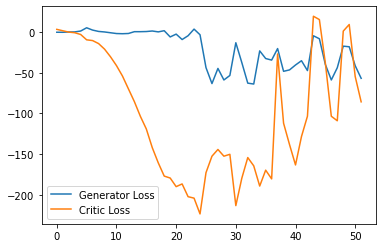

Step 1100: Generator loss: -51.29262979269028, critic loss: -87.3404685211182


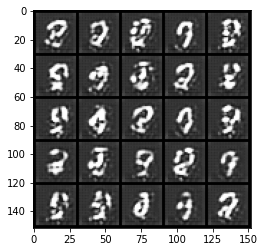

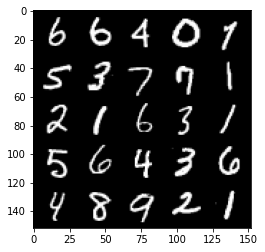

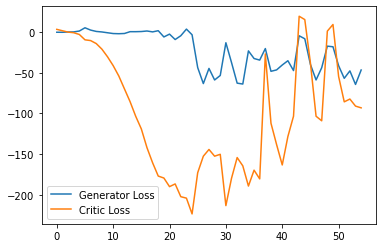

Step 1150: Generator loss: -21.48247356414795, critic loss: -3.115044292449947


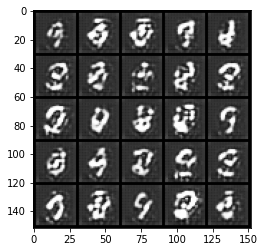

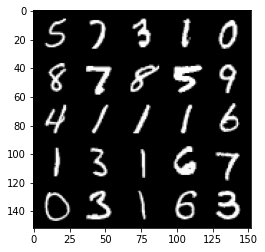

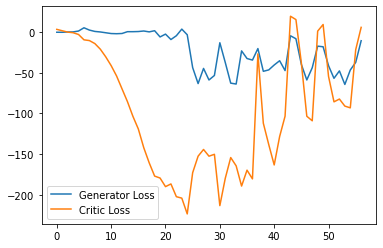

Step 1200: Generator loss: -11.22712911605835, critic loss: 4.435230438232422


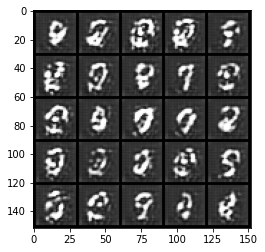

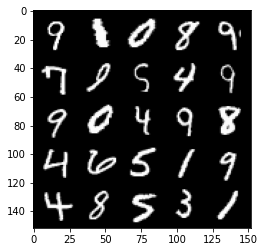

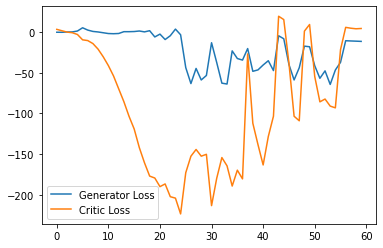

Step 1250: Generator loss: -11.480815868377686, critic loss: 2.1786727313995367


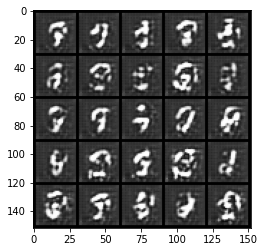

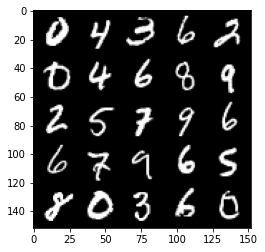

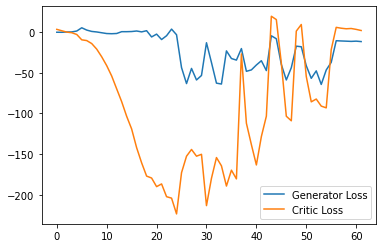

Step 1300: Generator loss: -12.594709835052491, critic loss: -1.5877619180679323


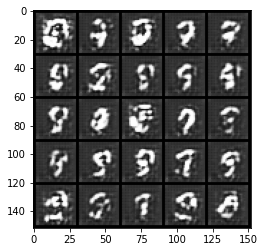

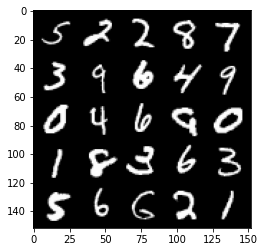

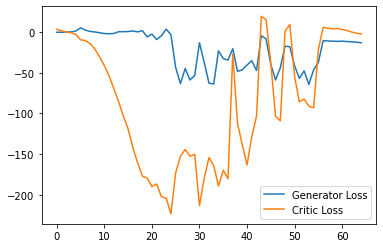

Step 1350: Generator loss: -15.216748752593993, critic loss: -3.949230983734131


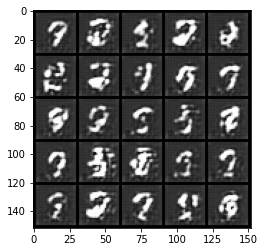

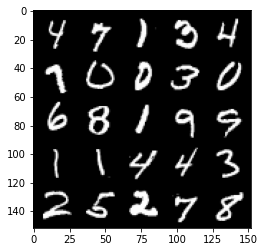

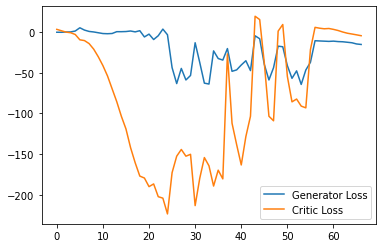

Step 1400: Generator loss: -19.641523952484132, critic loss: -2.1445848617553707


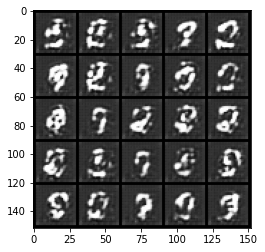

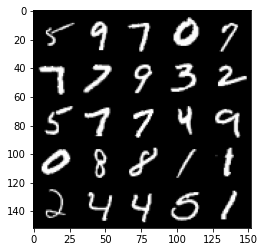

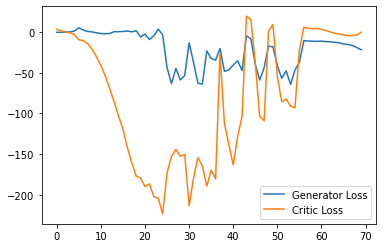

Step 1450: Generator loss: -23.577671241760253, critic loss: 1.9393821220397944


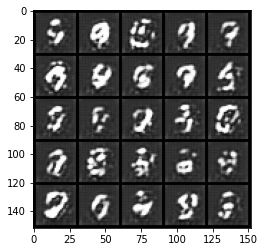

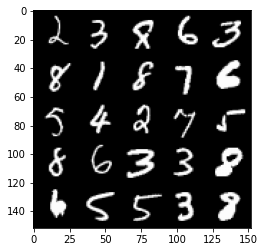

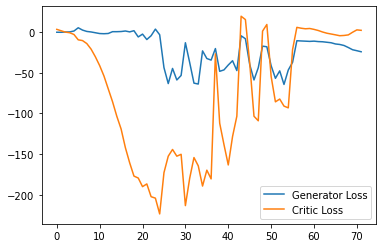

Step 1500: Generator loss: -22.695116329193116, critic loss: -6.048564804077147


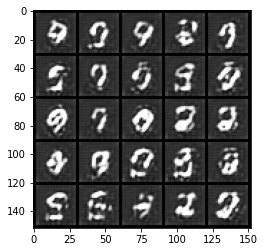

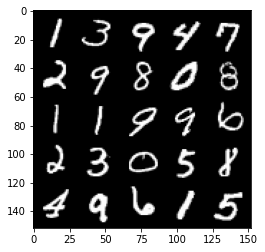

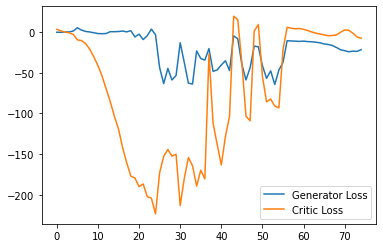

Step 1550: Generator loss: -22.38446985244751, critic loss: -11.120565025329588


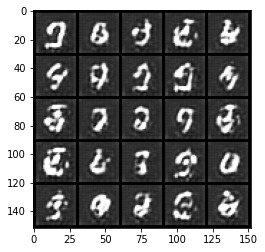

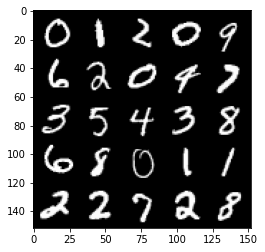

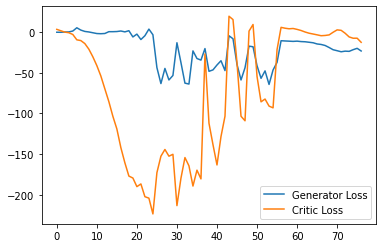

Step 1600: Generator loss: -23.938332872390745, critic loss: -21.308578918457037


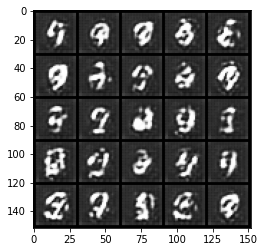

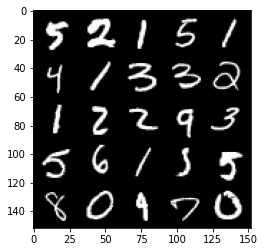

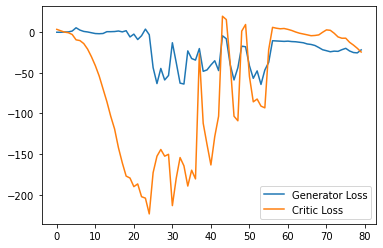

Step 1650: Generator loss: -25.18053779602051, critic loss: -26.265028312683107


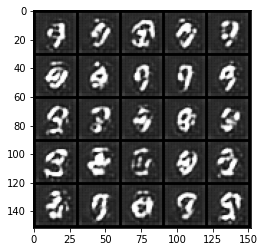

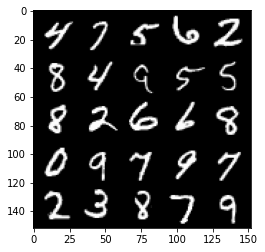

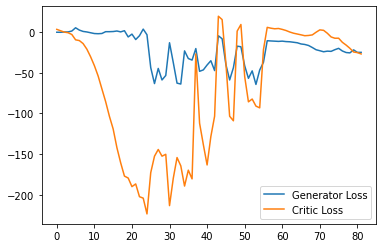

Step 1700: Generator loss: -24.65556879043579, critic loss: -15.13060391235352


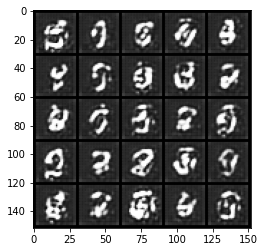

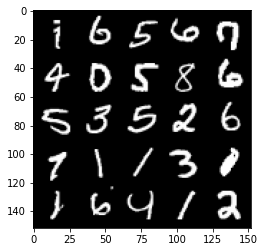

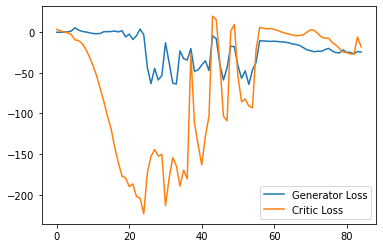

Step 1750: Generator loss: -26.49128776550293, critic loss: -19.878848560333257


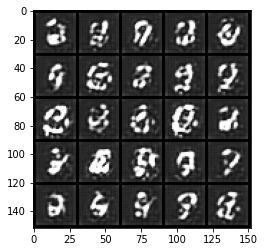

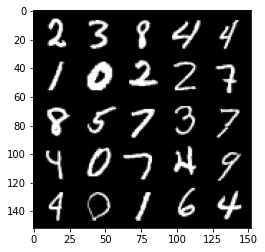

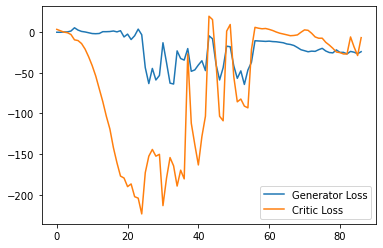

Step 1800: Generator loss: -26.365460295677185, critic loss: -28.250076965332024


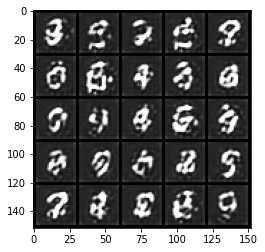

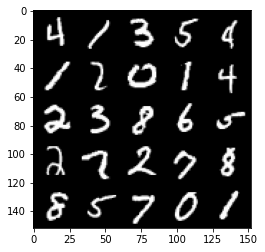

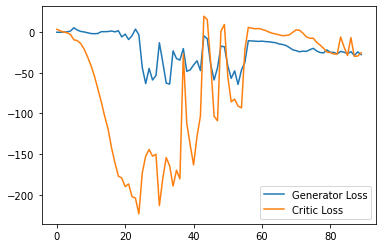

Step 1850: Generator loss: -26.954398670196532, critic loss: -21.30779086303711


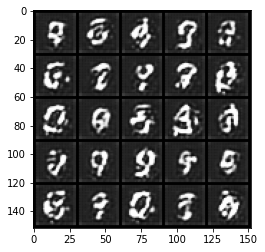

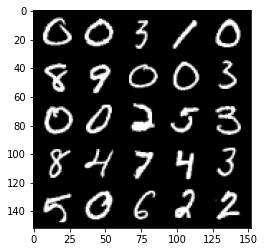

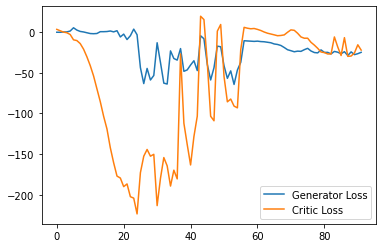

Step 1900: Generator loss: -27.663216321468354, critic loss: -21.287873182296753


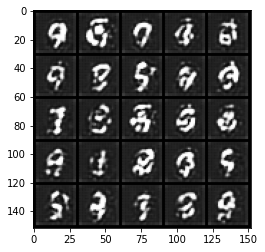

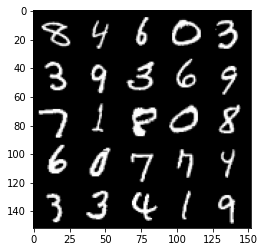

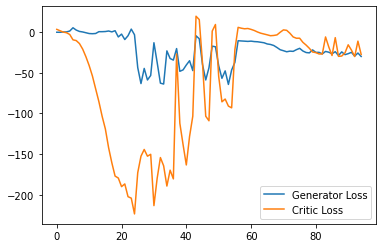

Step 1950: Generator loss: -23.59645595550537, critic loss: -25.054878471374508


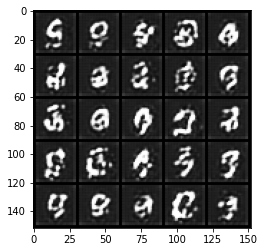

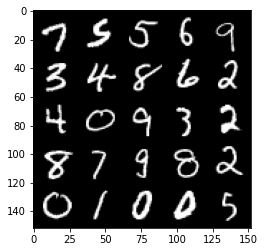

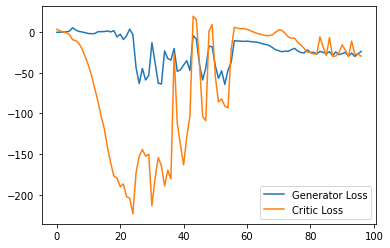

Step 2000: Generator loss: -23.352765445709228, critic loss: -23.838529912948605


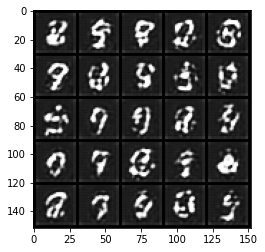

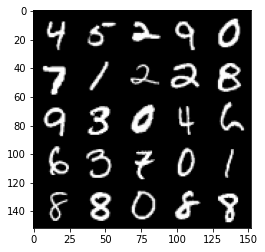

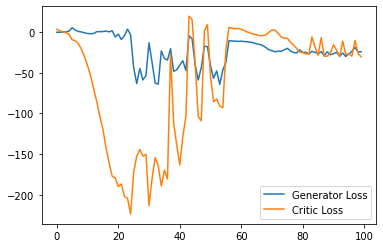

Step 2050: Generator loss: -18.736243228912354, critic loss: -3.1122670259475718


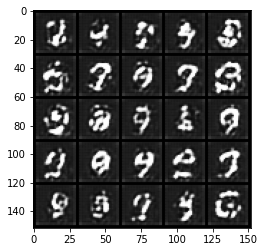

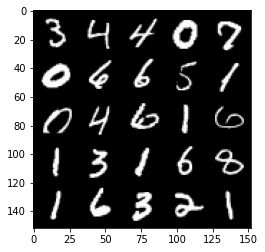

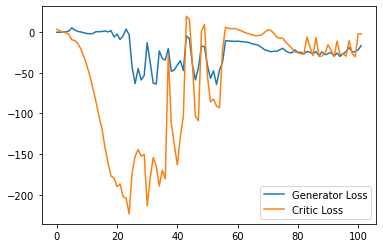

Step 2100: Generator loss: -26.108969841003418, critic loss: -27.61417069244385


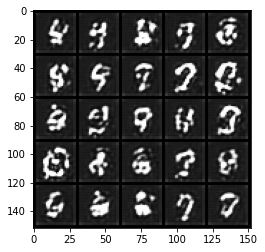

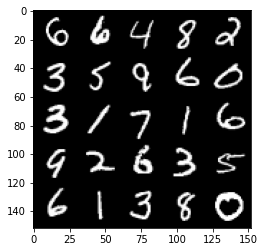

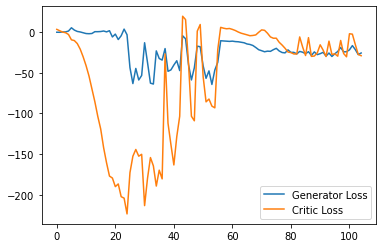

Step 2150: Generator loss: -18.840435485839844, critic loss: -6.8564121718406685


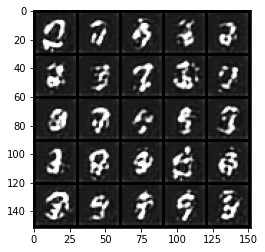

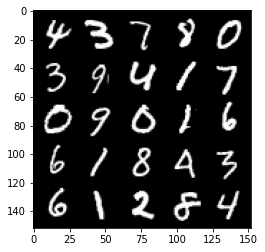

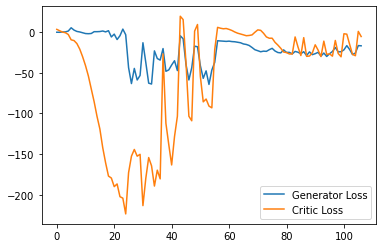

Step 2200: Generator loss: -22.252582149505614, critic loss: -18.272616444587708


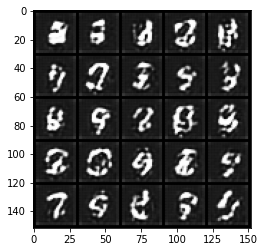

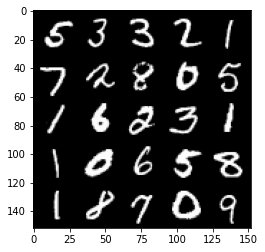

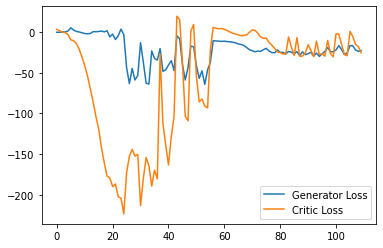

Step 2250: Generator loss: -16.013232555389404, critic loss: -7.898560322284696


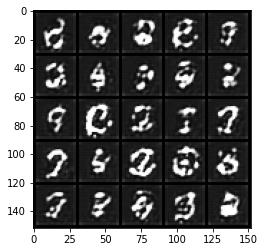

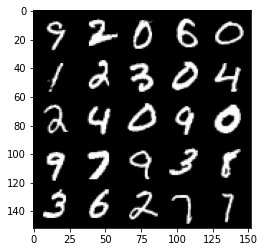

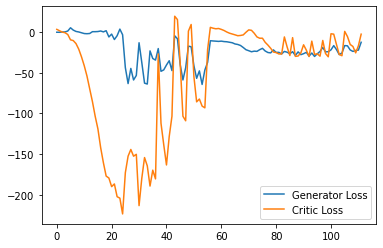

Step 2300: Generator loss: -15.809883670806885, critic loss: -7.718275057315829


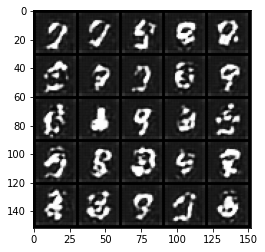

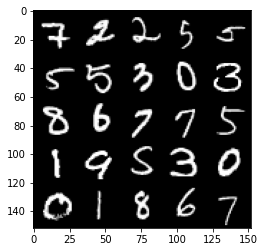

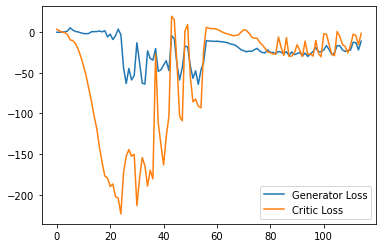

Step 2350: Generator loss: -12.749551219940185, critic loss: -4.888470054149627


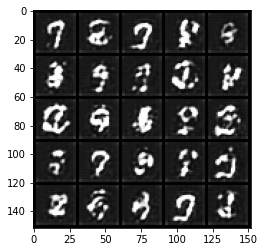

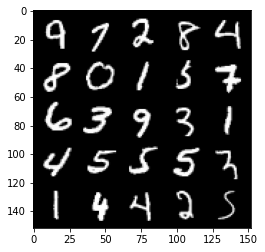

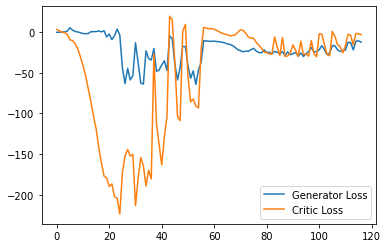

Step 2400: Generator loss: -20.64719358444214, critic loss: -19.565964670181273


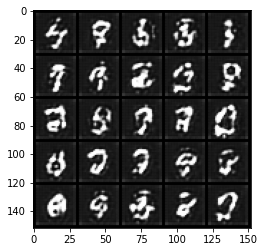

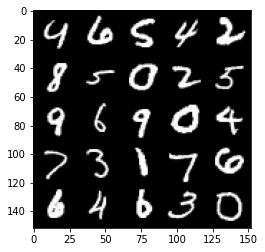

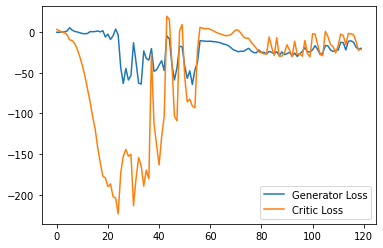

Step 2450: Generator loss: -19.30977728843689, critic loss: -22.38791208648682


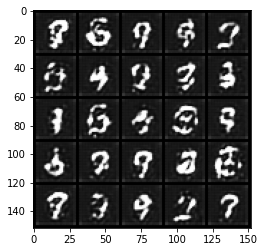

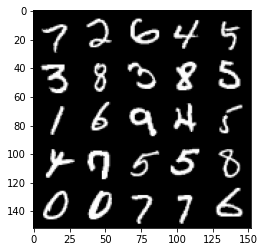

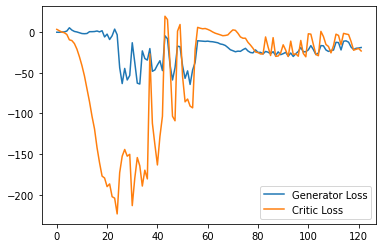

Step 2500: Generator loss: -12.690996866226197, critic loss: -11.797617791652678


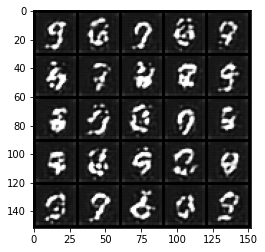

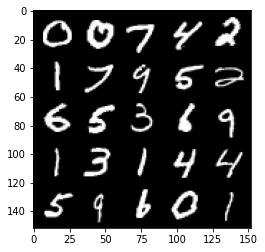

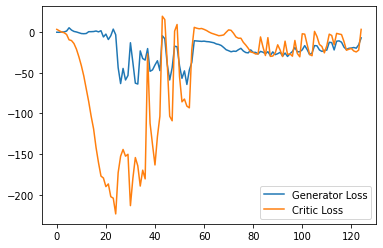

Step 2550: Generator loss: -7.361419305801392, critic loss: -3.502197566986085


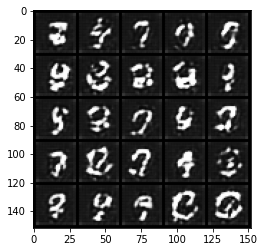

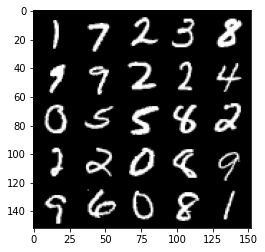

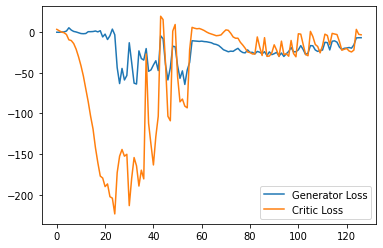

Step 2600: Generator loss: -15.119233908653259, critic loss: -14.217478390693664


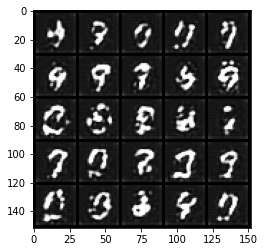

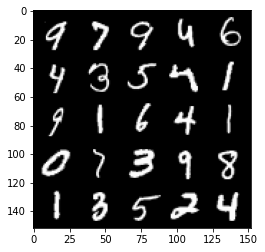

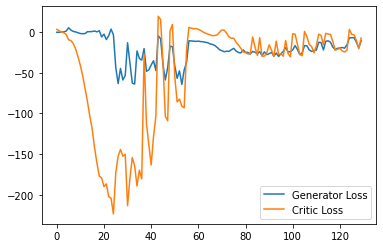

Step 2650: Generator loss: -13.680848858356477, critic loss: -14.896048254966734


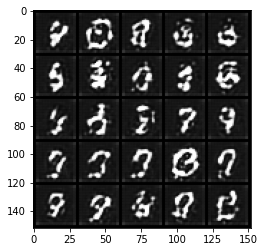

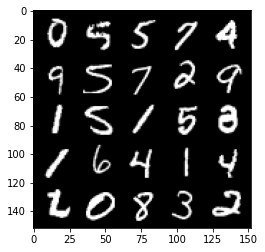

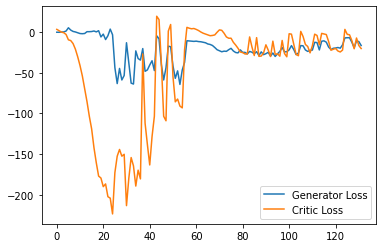

Step 2700: Generator loss: -5.469513206481934, critic loss: -2.4463559012413025


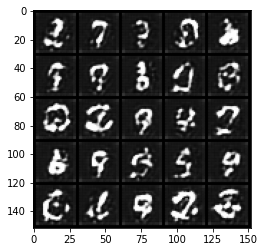

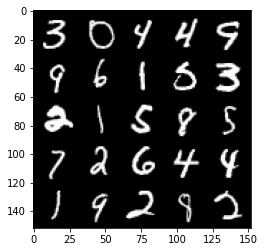

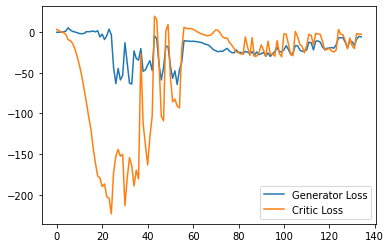

Step 2750: Generator loss: -8.529817924499511, critic loss: -6.021114904403687


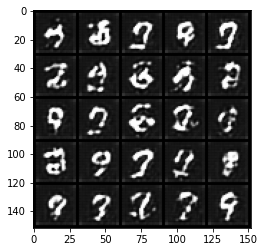

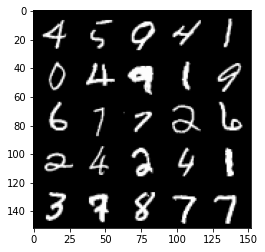

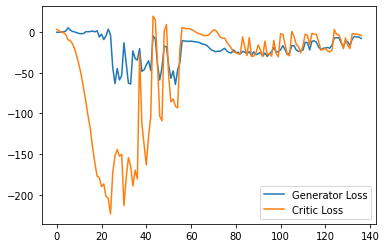

Step 2800: Generator loss: -16.661926164627076, critic loss: -20.336442138671874


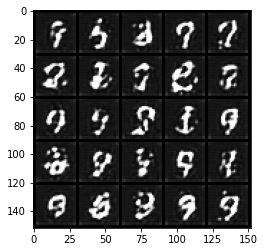

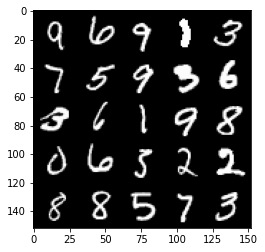

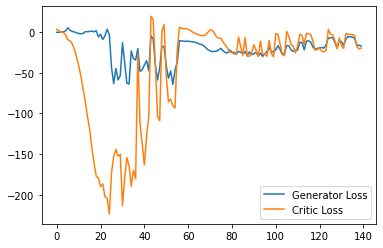

Step 2850: Generator loss: -2.382659921720624, critic loss: -2.197895994663239


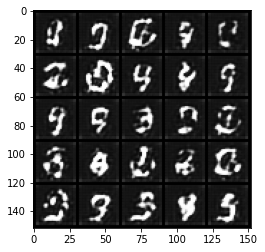

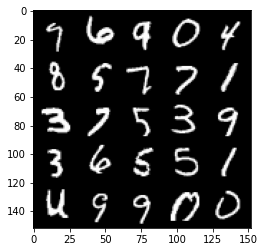

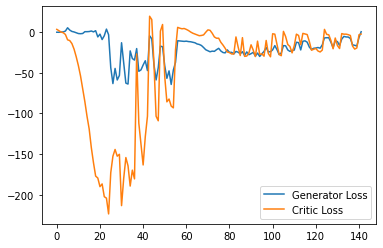

Step 2900: Generator loss: -2.669333345890045, critic loss: -2.3927594676017767


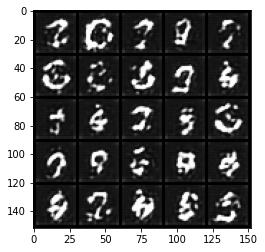

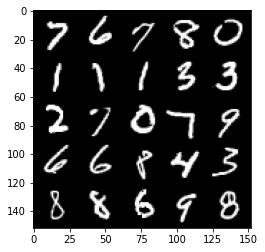

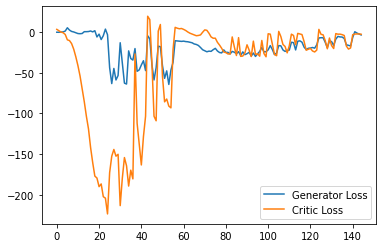

Step 2950: Generator loss: -5.04264301776886, critic loss: -2.9561247644424435


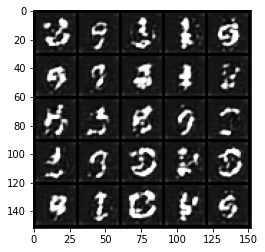

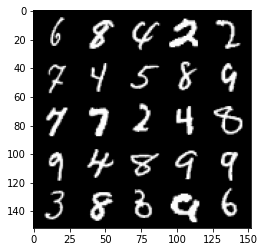

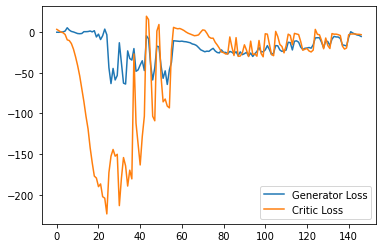

Step 3000: Generator loss: -7.269541368484497, critic loss: -6.731540702819824


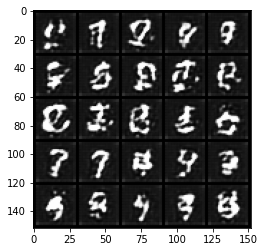

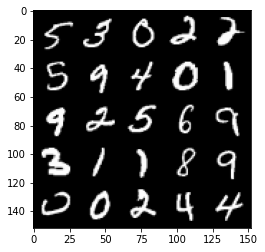

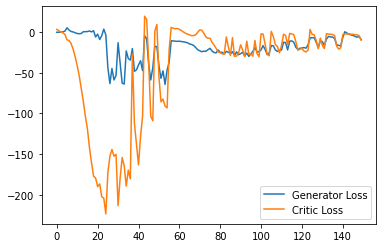

Step 3050: Generator loss: -13.92112408220768, critic loss: -14.323948934555055


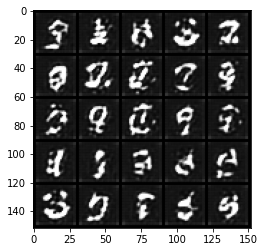

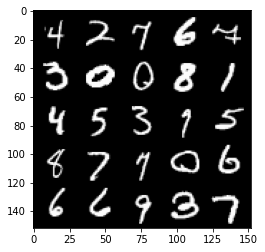

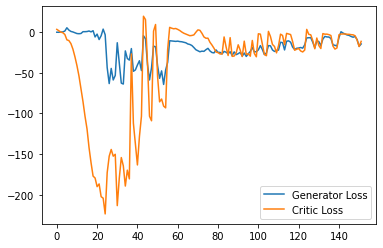

Step 3100: Generator loss: -11.080221640616655, critic loss: -15.212420109272005


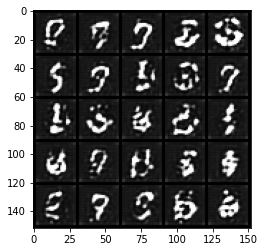

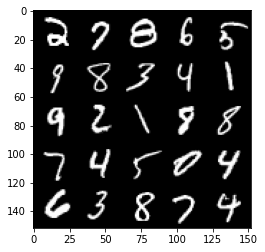

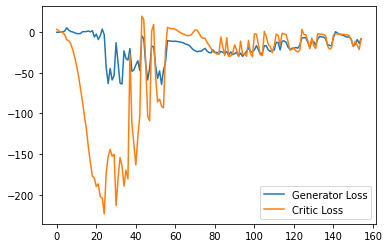

Step 3150: Generator loss: -7.559271446466446, critic loss: -14.409160714149472


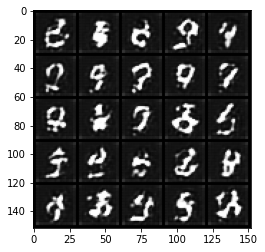

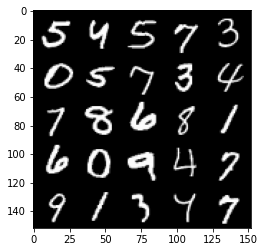

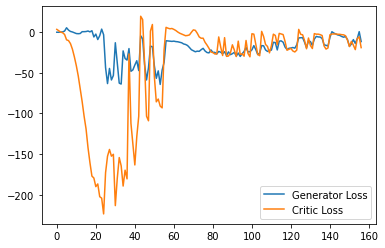

Step 3200: Generator loss: -14.542417635917664, critic loss: -18.737852690696716


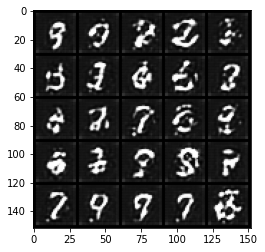

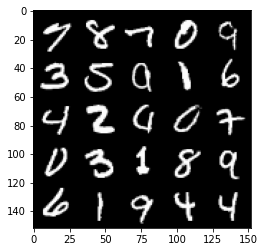

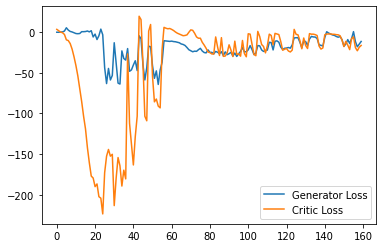

Step 3250: Generator loss: -11.09074683740735, critic loss: -17.874015697479248


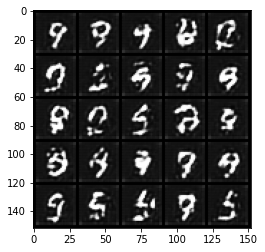

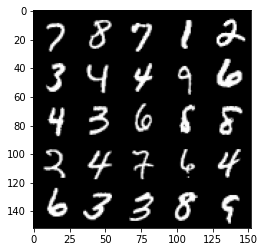

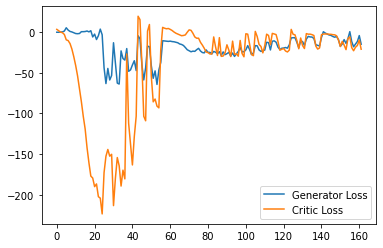

Step 3300: Generator loss: -8.529061843156814, critic loss: -15.390638864994049


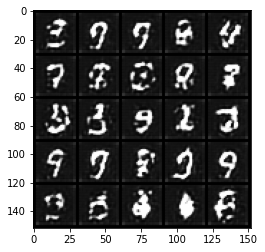

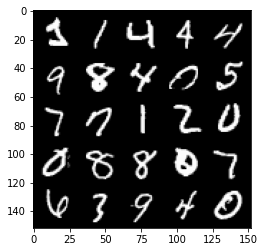

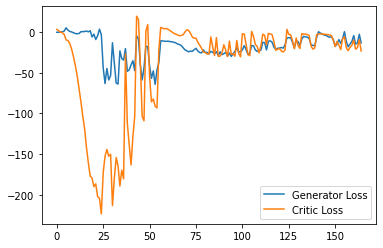

Step 3350: Generator loss: -3.855846648812294, critic loss: -3.041684820175172


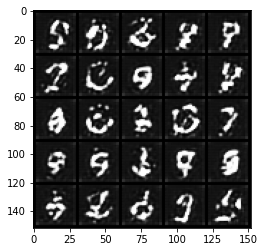

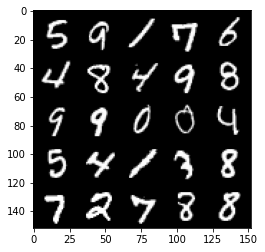

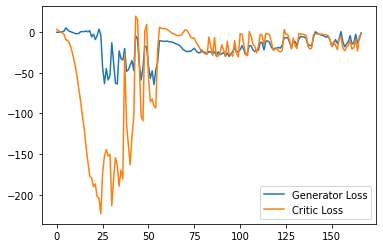

Step 3400: Generator loss: -4.214078602790832, critic loss: -3.368740644931793


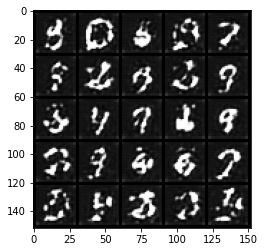

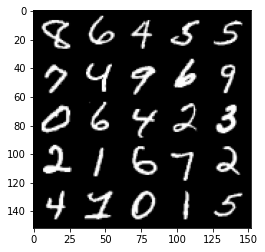

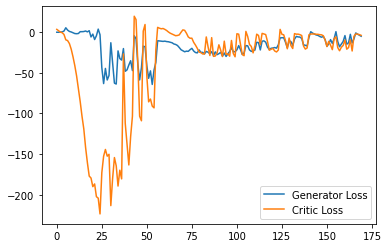

Step 3450: Generator loss: -12.427584418058395, critic loss: -17.771142810821534


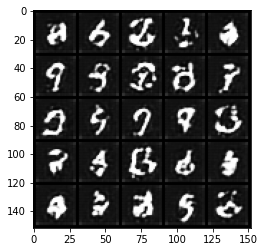

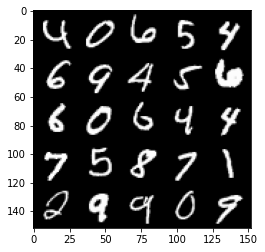

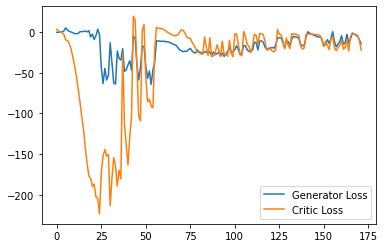

Step 3500: Generator loss: -12.640238695144653, critic loss: -21.584596411705014


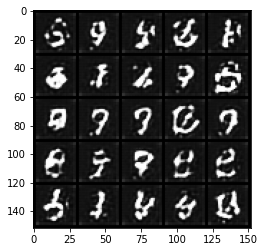

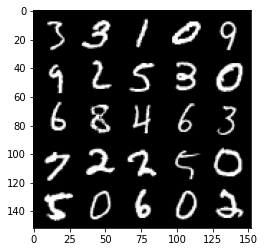

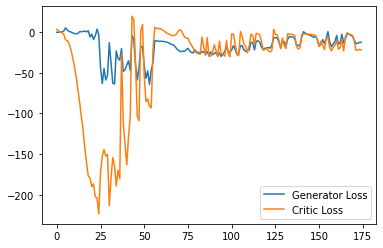

Step 3550: Generator loss: -9.056423895359039, critic loss: -20.39124361228943


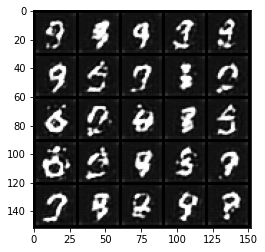

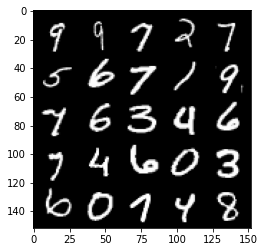

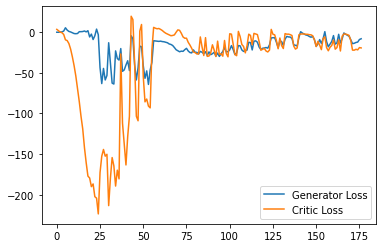

Step 3600: Generator loss: -5.4139976716041565, critic loss: -14.492452322006232


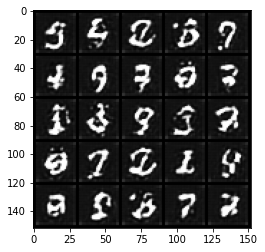

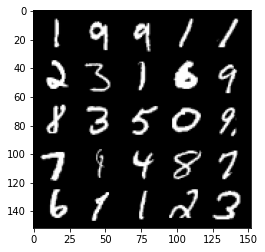

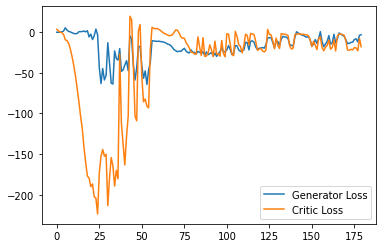

Step 3650: Generator loss: -9.022129369974136, critic loss: -14.99133597755432


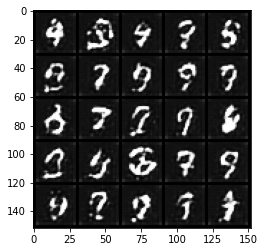

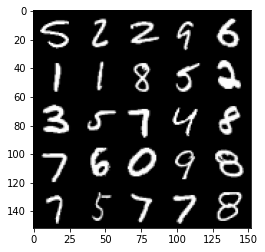

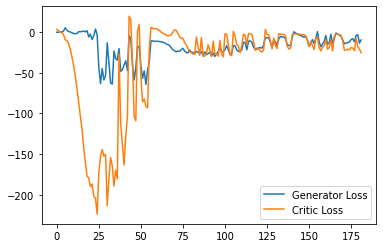

Step 3700: Generator loss: -0.959625607430935, critic loss: -2.078635410785675


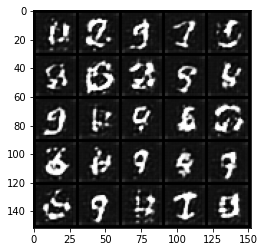

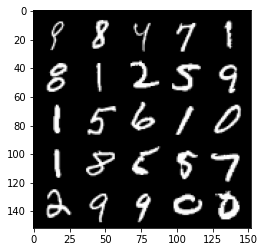

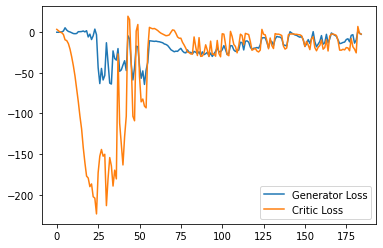

Step 3750: Generator loss: -3.0838251066207887, critic loss: -3.837499134063721


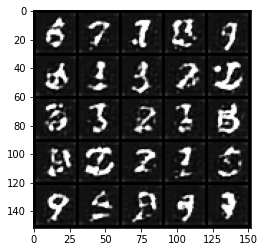

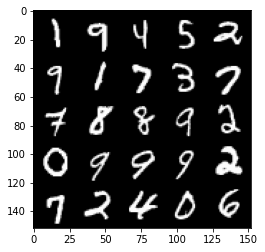

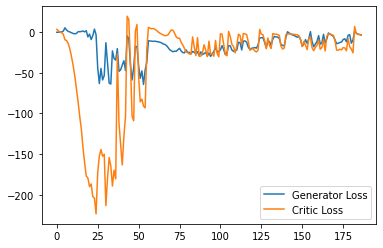

Step 3800: Generator loss: -8.748454932123423, critic loss: -17.47072556877136


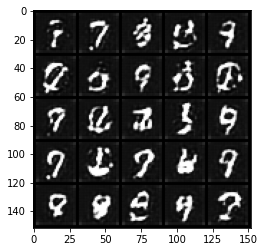

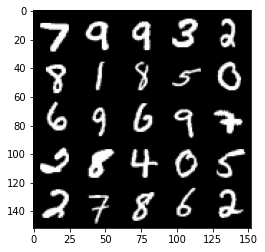

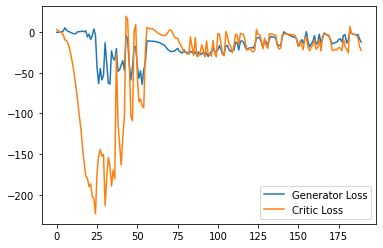

Step 3850: Generator loss: -8.881162174642085, critic loss: -22.88220589542389


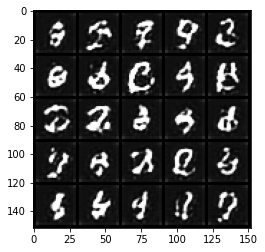

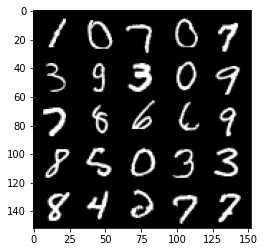

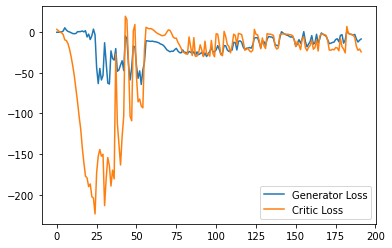

Step 3900: Generator loss: 0.6227937924861908, critic loss: -7.280783098697661


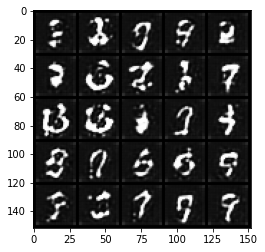

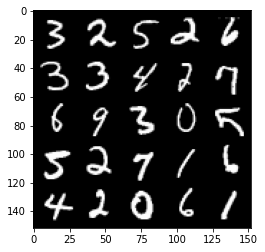

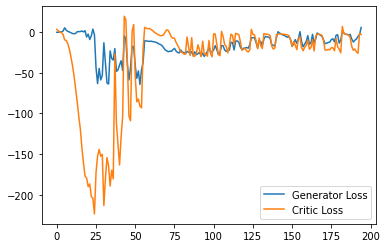

Step 3950: Generator loss: 3.2734347772598267, critic loss: -3.4908258342742915


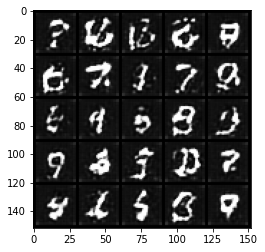

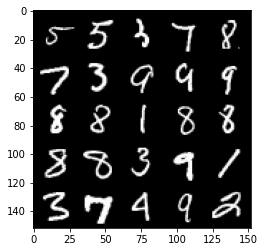

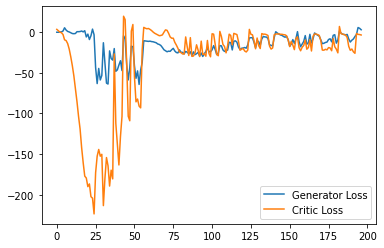

Step 4000: Generator loss: -3.15946829456836, critic loss: -12.021862417221069


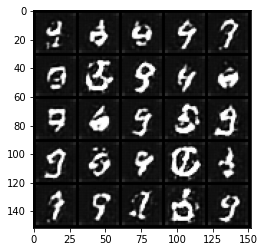

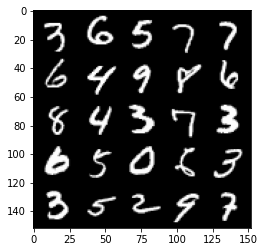

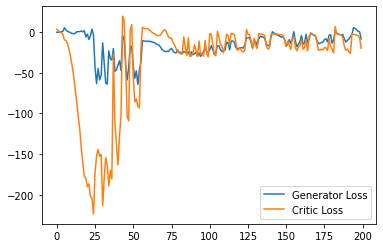

Step 4050: Generator loss: 0.9553183937072753, critic loss: -6.328032910823819


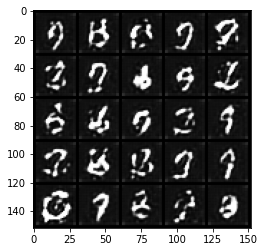

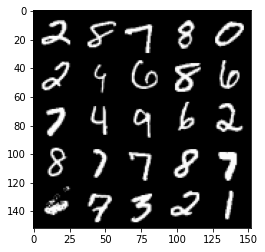

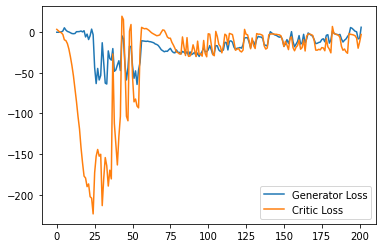

Step 4100: Generator loss: 4.269367318153382, critic loss: -3.662870134353638


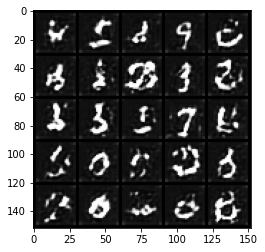

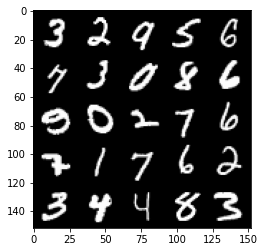

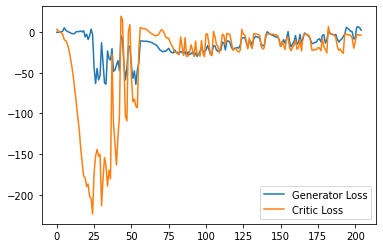

Step 4150: Generator loss: -4.131756011843681, critic loss: -15.016330987930301


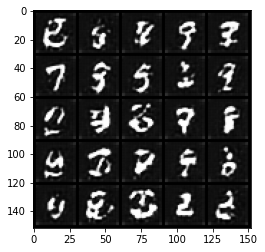

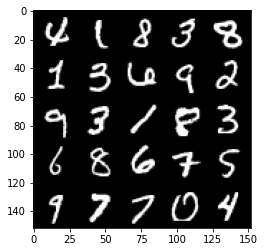

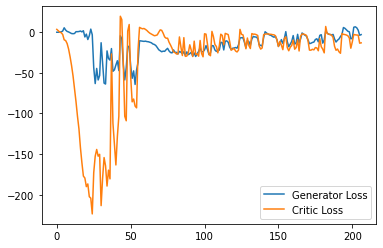

Step 4200: Generator loss: -3.286734127998352, critic loss: -20.650197909832


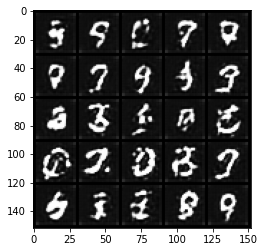

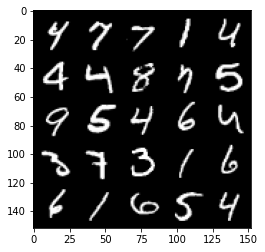

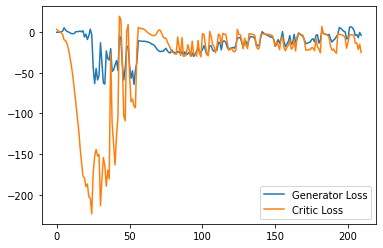

Step 4250: Generator loss: -4.124427990913391, critic loss: -20.59923835277558


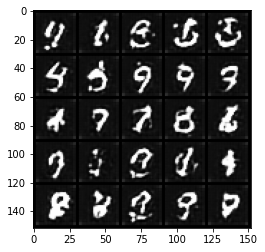

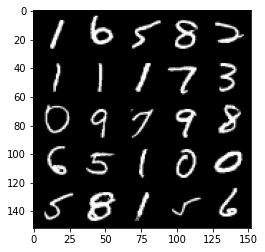

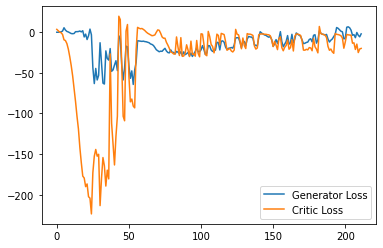

Step 4300: Generator loss: 5.283799322843552, critic loss: -1.1656832613945018


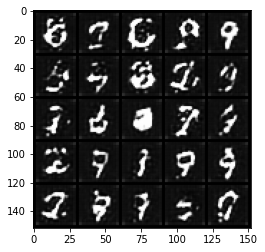

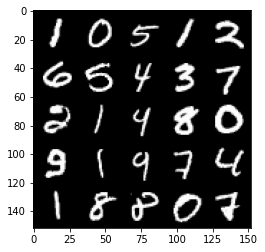

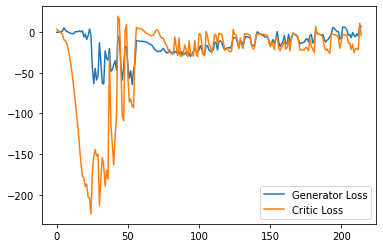

Step 4350: Generator loss: 4.707683365345002, critic loss: -6.586637224674223


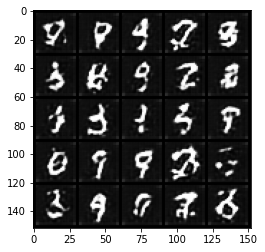

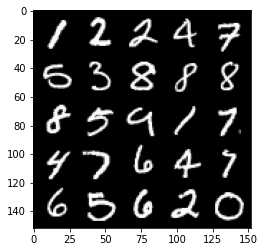

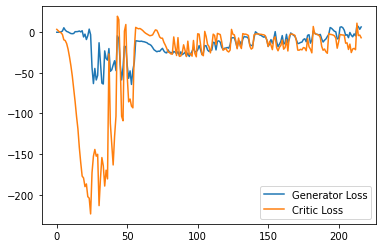

Step 4400: Generator loss: -2.9403731486201288, critic loss: -23.315269538402553


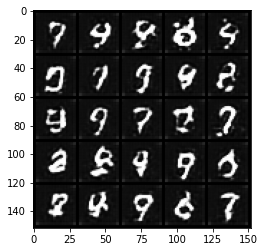

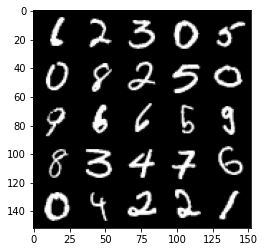

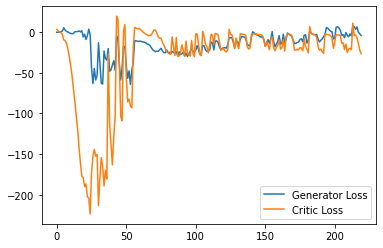

Step 4450: Generator loss: -0.13651156067848205, critic loss: -11.97537625646591


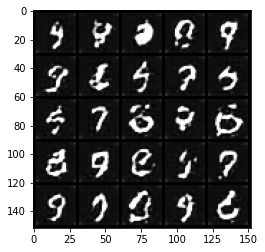

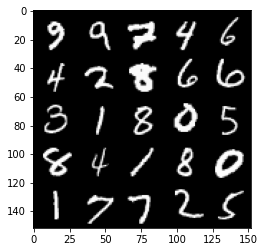

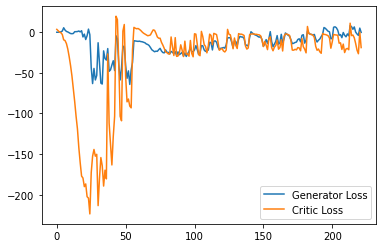

Step 4500: Generator loss: -2.658607841581106, critic loss: -21.850514706611634


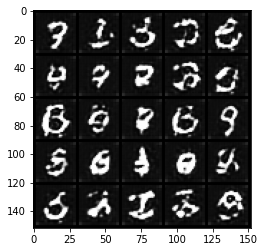

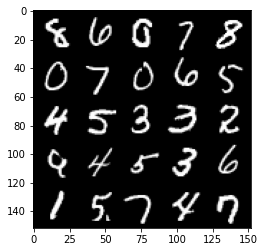

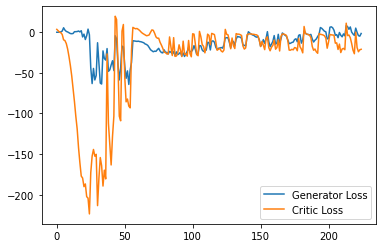

Step 4550: Generator loss: 6.10763547718525, critic loss: -6.147514338016513


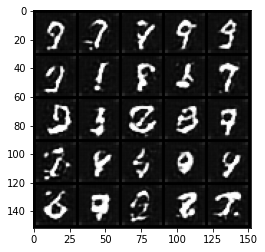

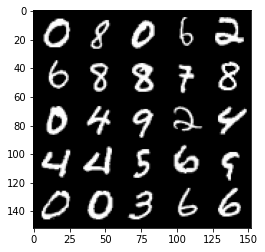

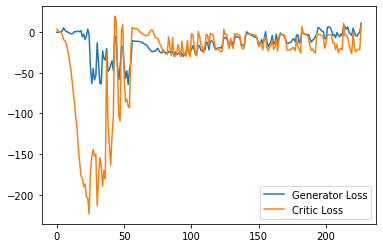

Step 4600: Generator loss: -0.4164514465630054, critic loss: -22.60174992752075


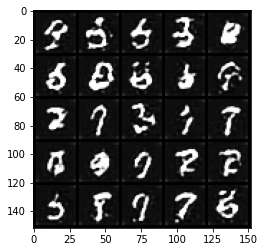

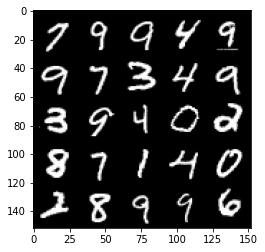

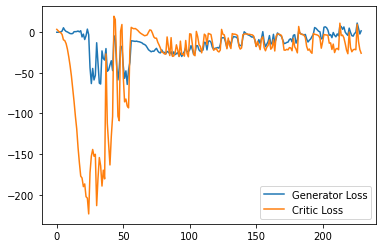

Step 4650: Generator loss: 3.982416571378708, critic loss: -19.891140636444092


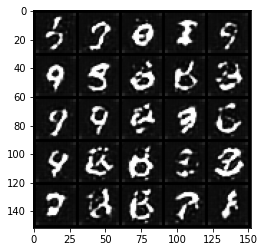

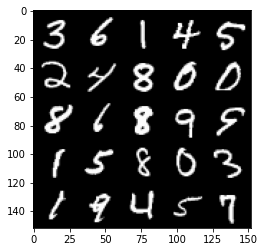

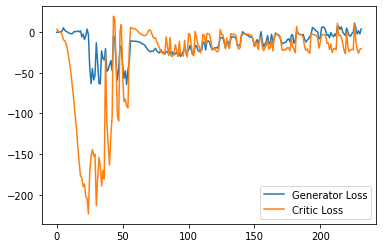

Step 4700: Generator loss: 0.18705718368291854, critic loss: -21.204089636802678


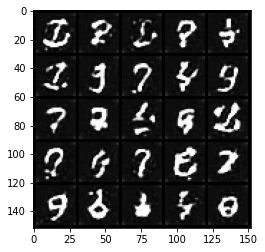

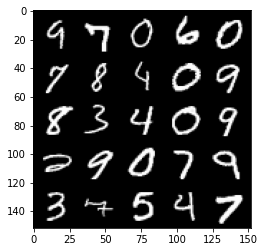

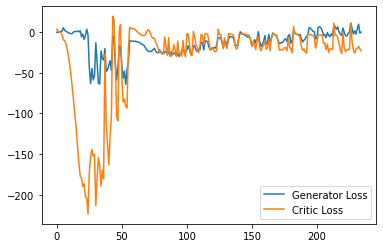

Step 4750: Generator loss: 1.472294917702675, critic loss: -21.436860907554625


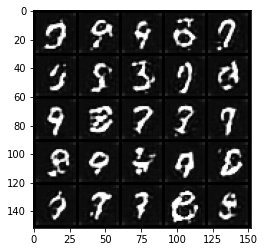

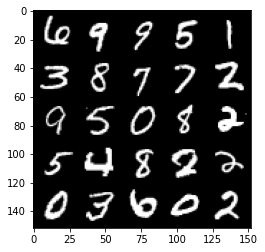

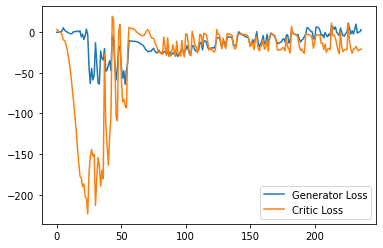

Step 4800: Generator loss: 9.237378032803536, critic loss: -9.08204036331177


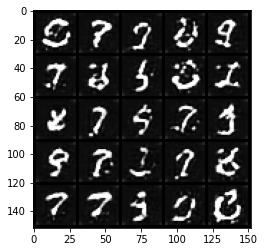

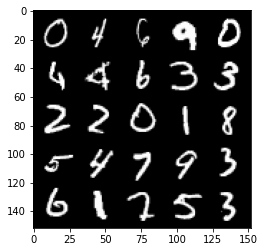

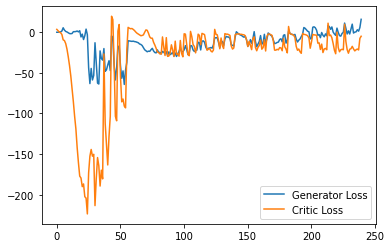

Step 4850: Generator loss: 4.261248876750469, critic loss: -18.461267464637764


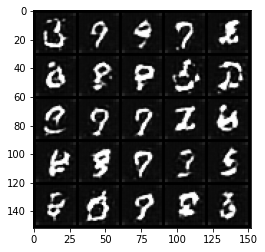

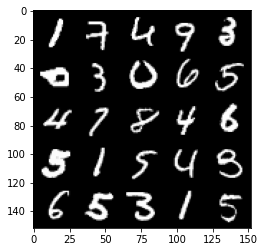

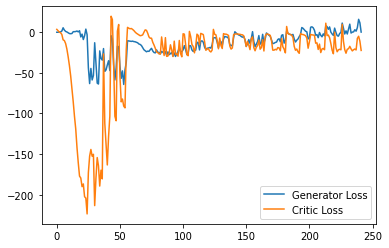

Step 4900: Generator loss: 3.2205459851026537, critic loss: -17.160124547004692


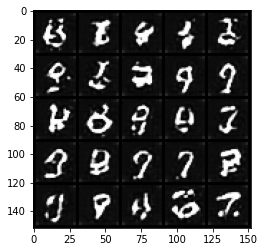

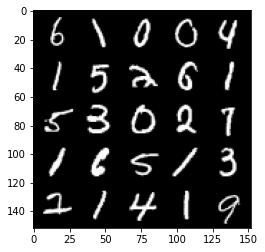

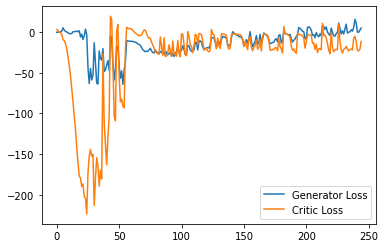

Step 4950: Generator loss: 15.067575550079345, critic loss: -3.5654189720153795


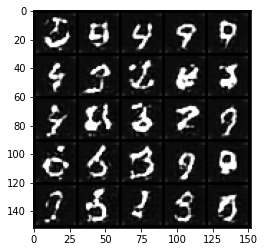

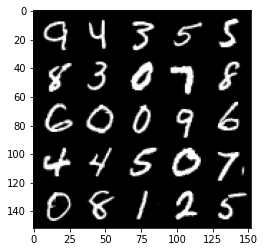

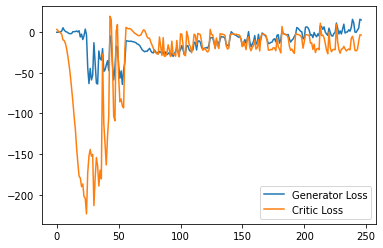

Step 5000: Generator loss: 6.471440690755844, critic loss: -9.18637215900421


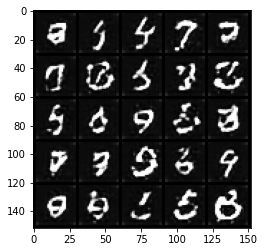

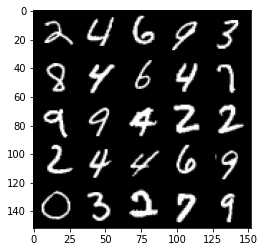

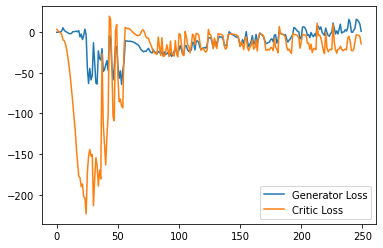

Step 5050: Generator loss: 4.8654188492894175, critic loss: -7.646313990592957


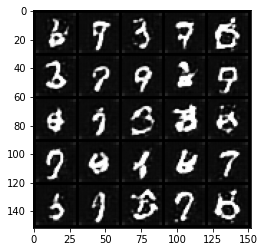

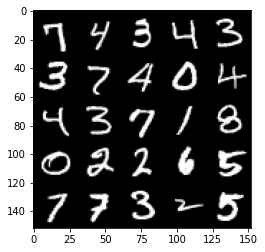

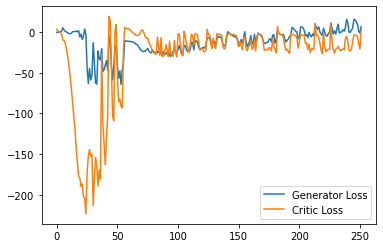

Step 5100: Generator loss: 12.753238506317139, critic loss: -3.158307527542113


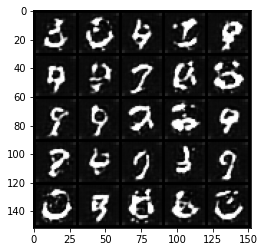

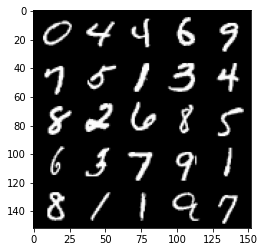

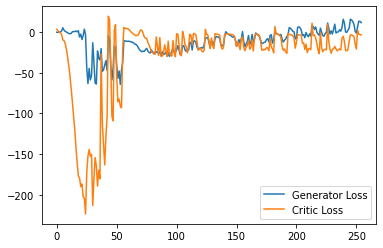

Step 5150: Generator loss: 8.400666393637657, critic loss: -6.997831087112427


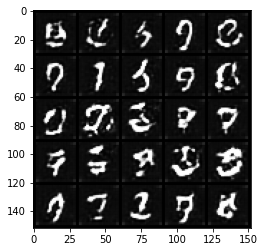

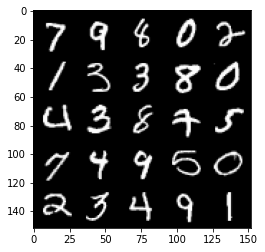

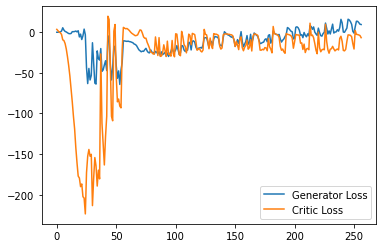

Step 5200: Generator loss: 4.708196257352829, critic loss: -16.825544789791113


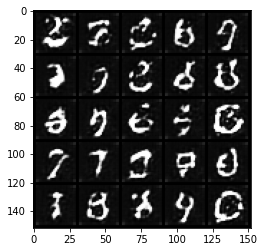

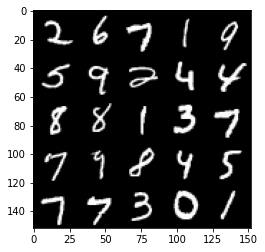

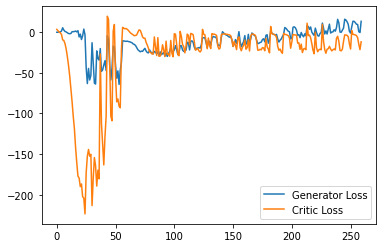

Step 5250: Generator loss: 4.6470781749486925, critic loss: -18.344851381301883


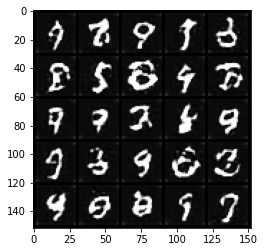

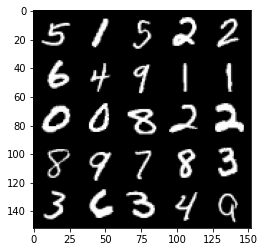

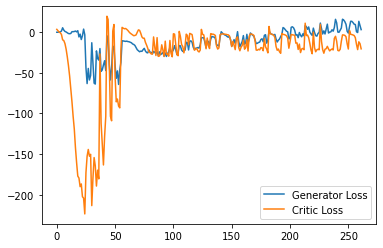

Step 5300: Generator loss: 4.604063902050257, critic loss: -20.793090380191803


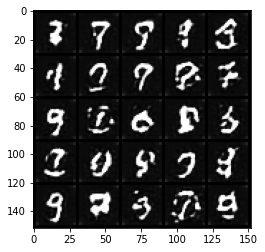

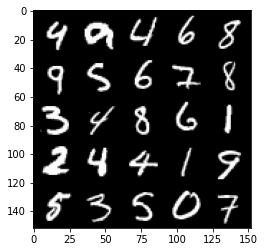

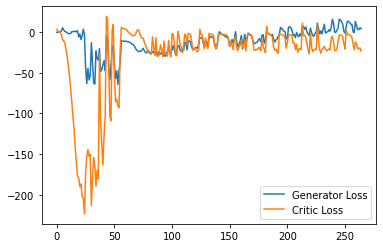

Step 5350: Generator loss: 10.870633647441863, critic loss: -7.494094669818879


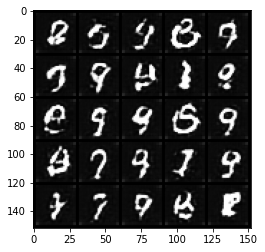

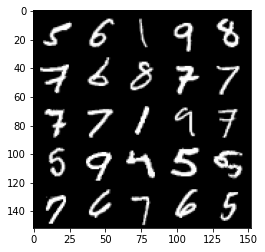

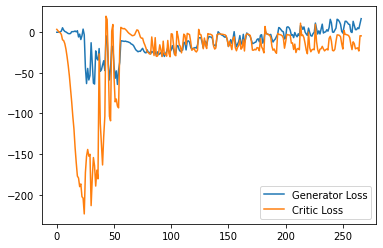

Step 5400: Generator loss: 7.363099706172943, critic loss: -17.6167350935936


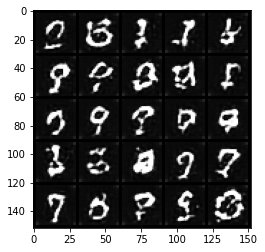

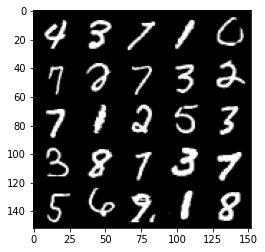

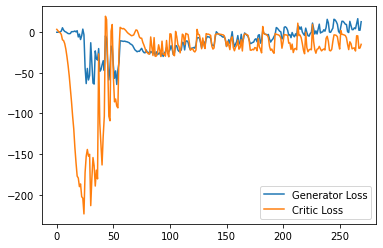

Step 5450: Generator loss: 7.765908262059092, critic loss: -17.48311736154556


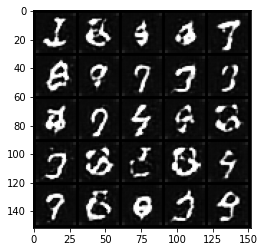

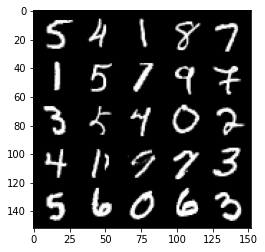

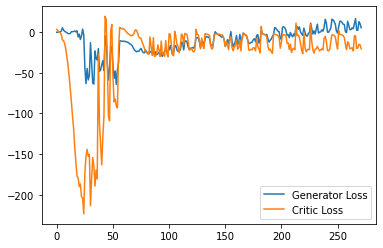

Step 5500: Generator loss: 9.269911473989486, critic loss: -21.036551030158993


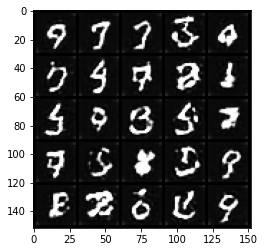

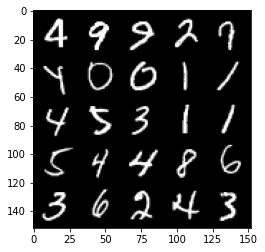

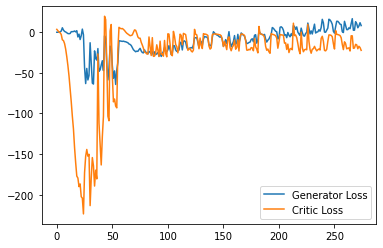

Step 5550: Generator loss: 6.334301711618901, critic loss: -21.67384283924103


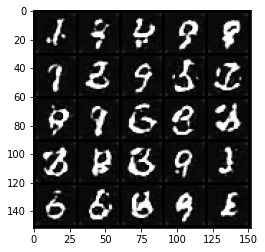

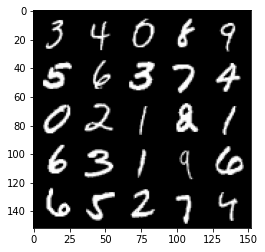

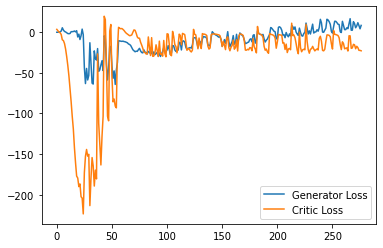

Step 5600: Generator loss: 16.398316207826138, critic loss: -6.368520533084873


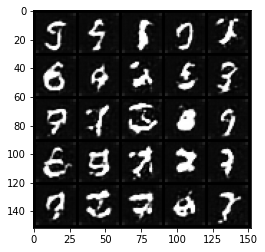

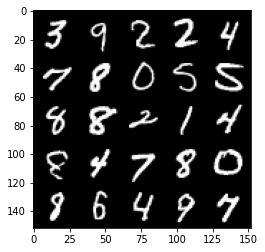

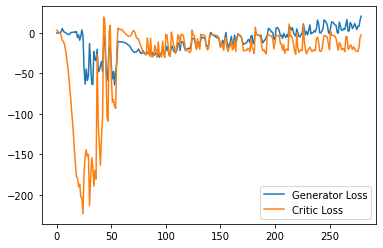

Step 5650: Generator loss: 20.255258522033692, critic loss: -3.0726414060592653


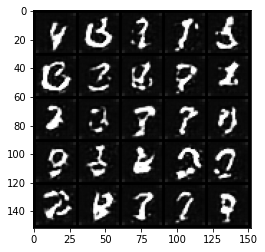

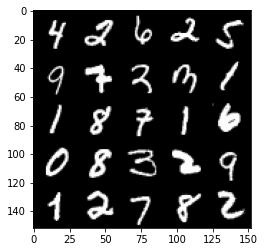

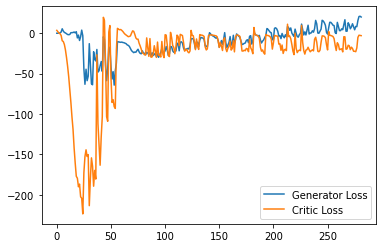

Step 5700: Generator loss: 17.257733364105224, critic loss: -5.346925352096556


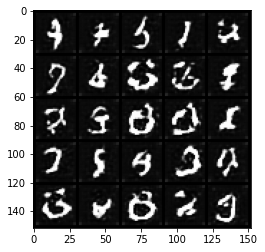

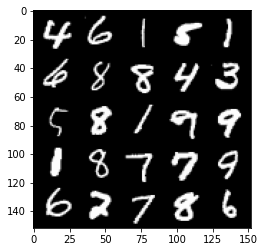

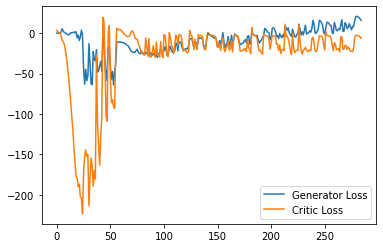

Step 5750: Generator loss: 5.521393916010856, critic loss: -21.558080700874324


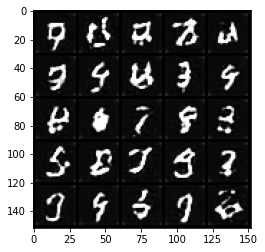

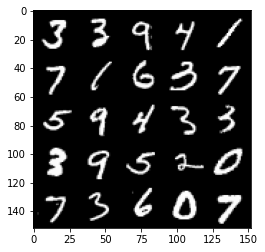

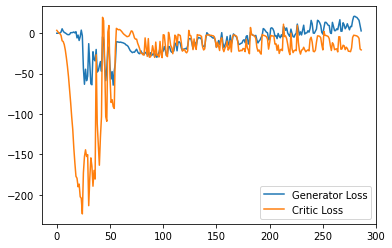

Step 5800: Generator loss: 11.062924612760543, critic loss: -17.228549602508547


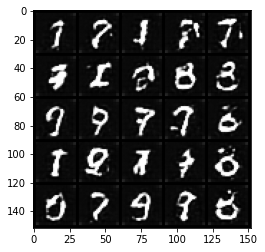

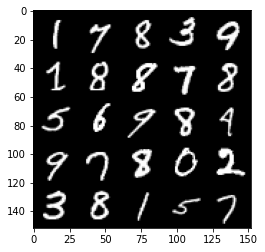

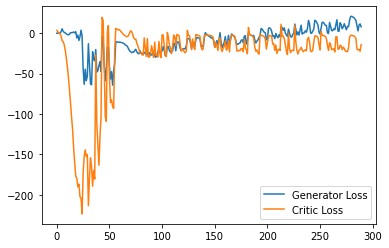

Step 5850: Generator loss: 17.48584447145462, critic loss: -4.258321800231935


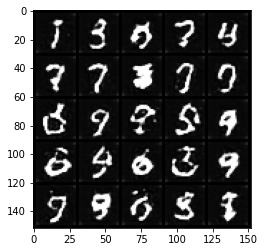

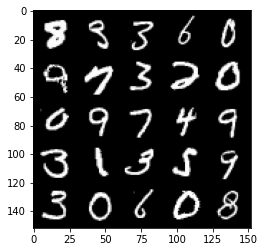

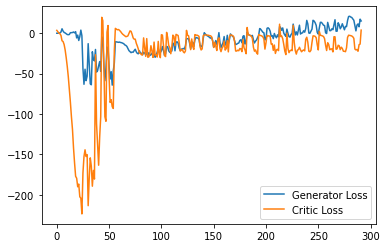

Step 5900: Generator loss: 21.59131633758545, critic loss: -2.1764924926757807


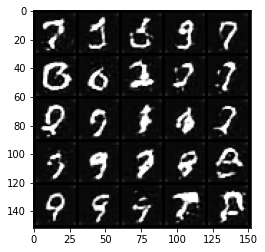

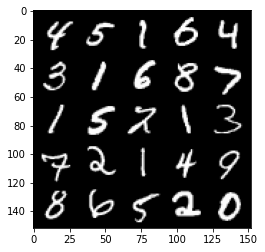

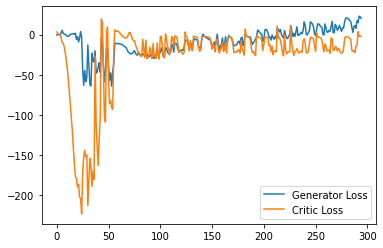

Step 5950: Generator loss: 18.091715621948243, critic loss: -2.724311968803406


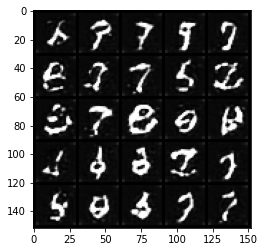

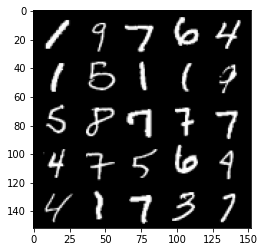

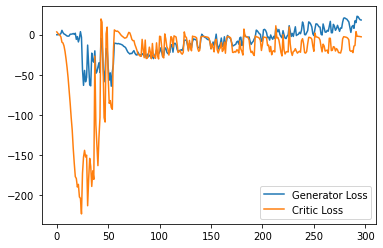

Step 6000: Generator loss: 16.21984851837158, critic loss: -3.7144630393981934


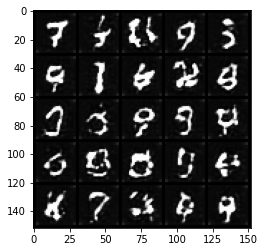

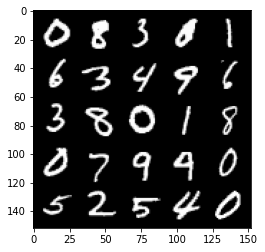

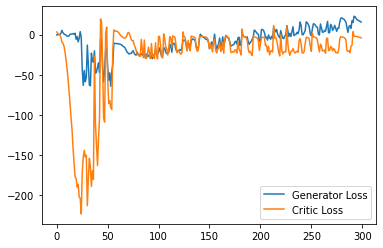

Step 6050: Generator loss: 10.288154864311219, critic loss: -9.447281310081484


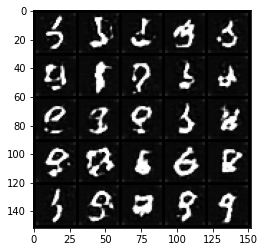

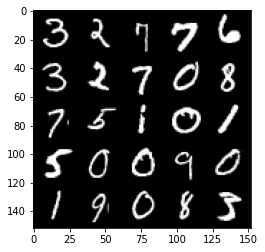

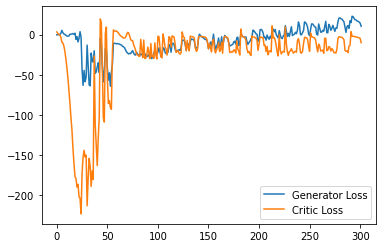

Step 6100: Generator loss: 13.343285454511642, critic loss: -8.67717201328278


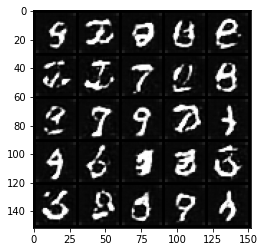

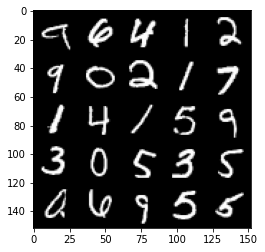

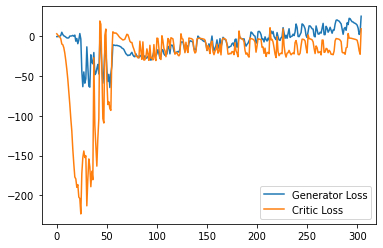

Step 6150: Generator loss: 22.687202835083006, critic loss: -2.8823158349990843


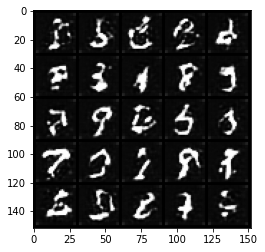

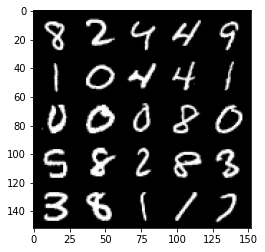

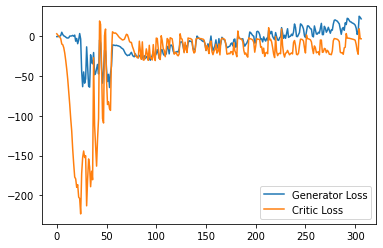

Step 6200: Generator loss: 18.17437068939209, critic loss: -3.581822762489318


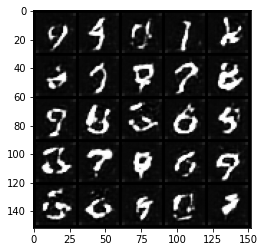

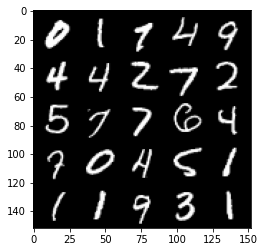

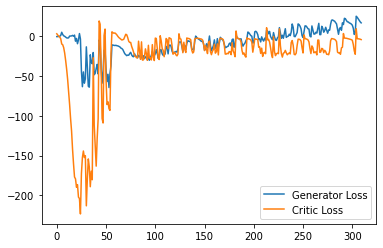

Step 6250: Generator loss: 11.135967450141907, critic loss: -13.02230959606171


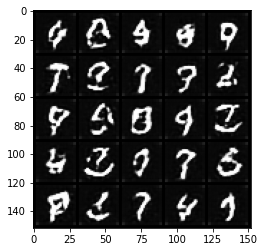

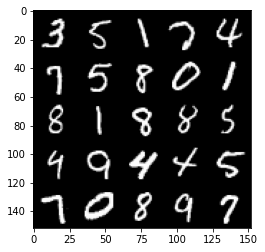

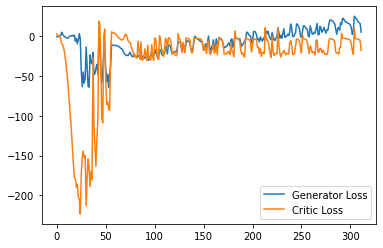

Step 6300: Generator loss: 11.076058963537216, critic loss: -19.977069925308225


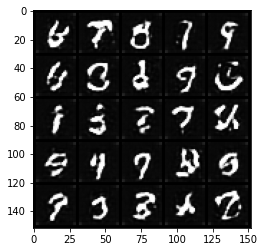

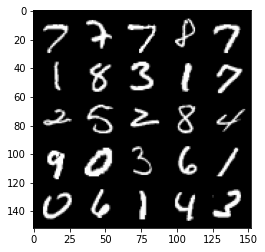

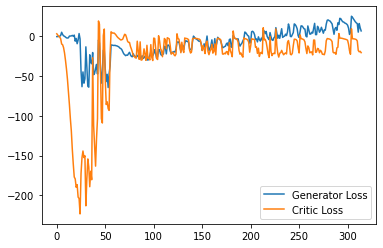

Step 6350: Generator loss: 8.72095881998539, critic loss: -23.439021481990817


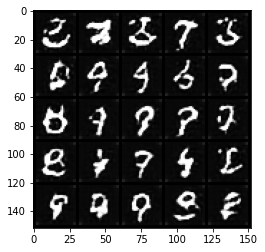

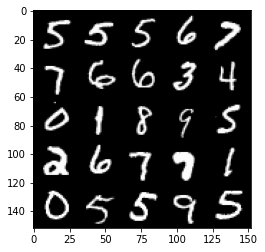

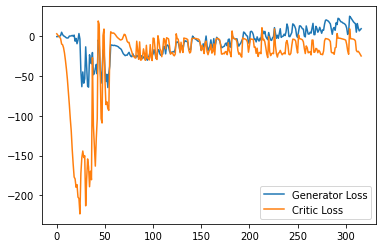

Step 6400: Generator loss: 23.224671468138695, critic loss: 3.947895089387896


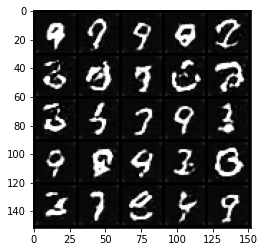

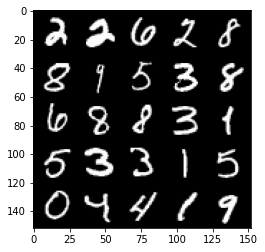

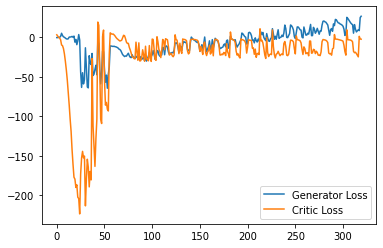

Step 6450: Generator loss: 25.636872596740723, critic loss: -2.361605532169342


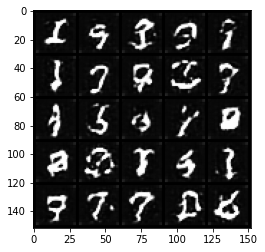

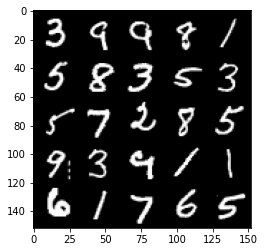

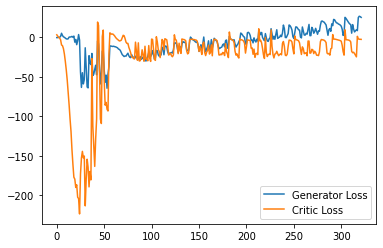

Step 6500: Generator loss: 23.112173652648927, critic loss: -2.6974208040237424


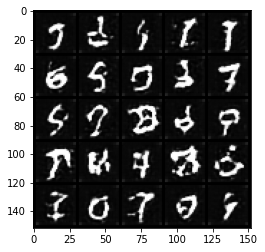

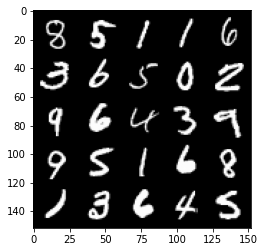

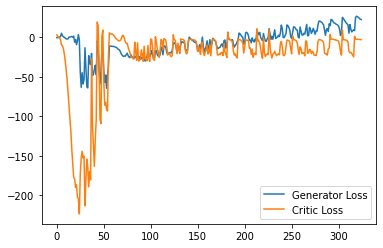

Step 6550: Generator loss: 21.63259651184082, critic loss: -2.9361253681182857


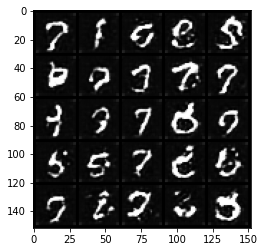

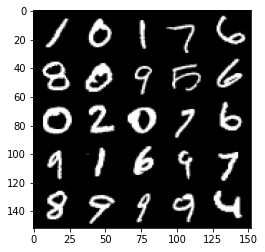

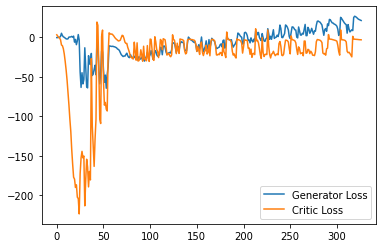

Step 6600: Generator loss: 20.16218521118164, critic loss: -3.1305232181549076


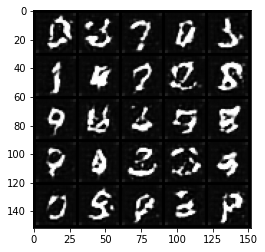

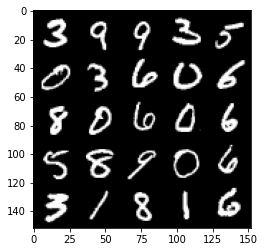

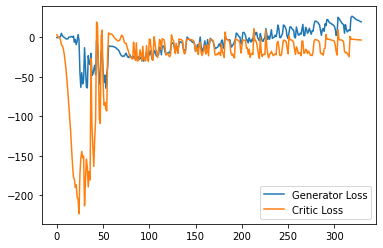

Step 6650: Generator loss: 18.9819246673584, critic loss: -4.063446514129639


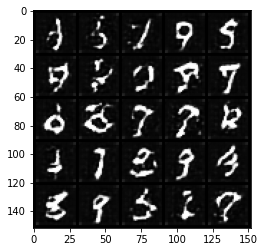

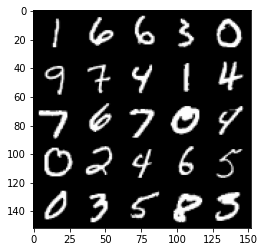

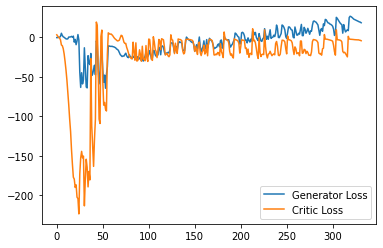

Step 6700: Generator loss: 13.069515876173973, critic loss: -11.763145513534548


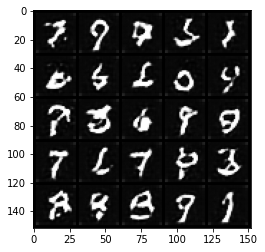

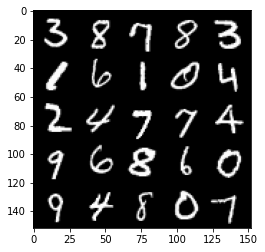

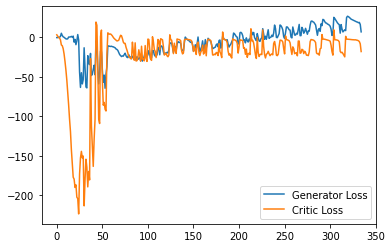

Step 6750: Generator loss: 12.4253085064888, critic loss: -18.71049337792396


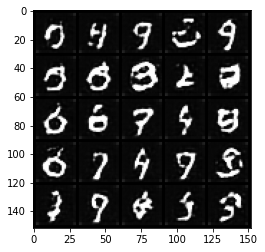

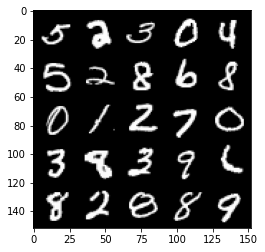

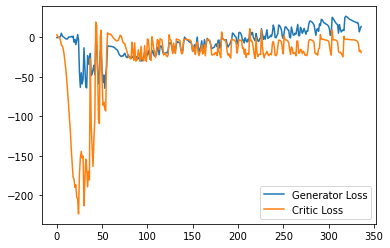

Step 6800: Generator loss: 6.924749866724015, critic loss: -24.337273084282874


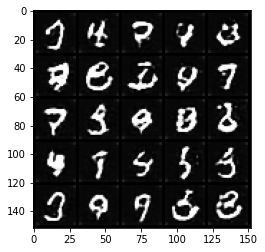

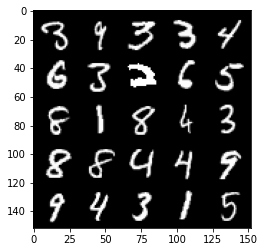

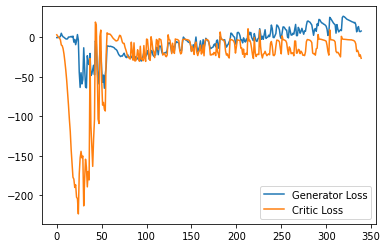

Step 6850: Generator loss: 15.562715303599834, critic loss: -22.49825011491776


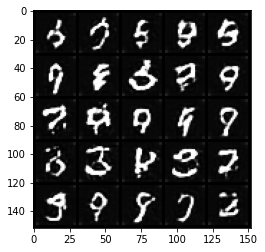

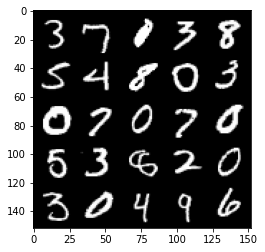

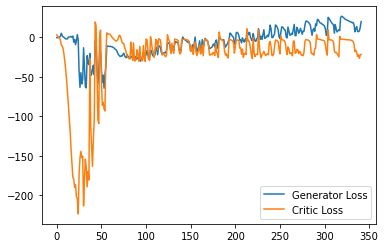

Step 6900: Generator loss: 15.061542419344187, critic loss: -17.278301450252528


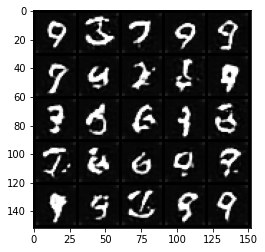

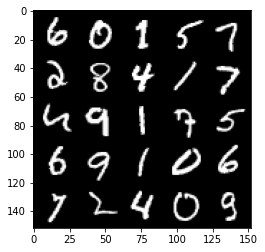

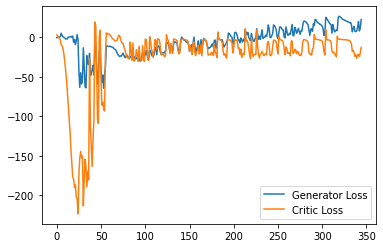

Step 6950: Generator loss: 11.605768627524377, critic loss: -21.887473598003375


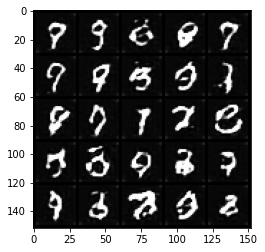

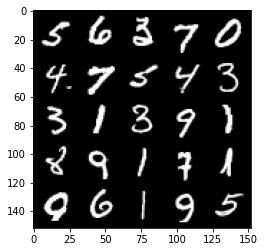

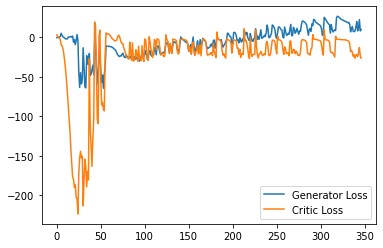

Step 7000: Generator loss: 15.176797235012055, critic loss: -20.197917484283447


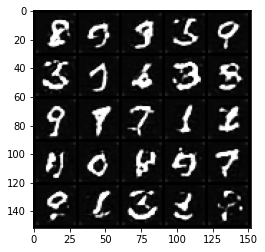

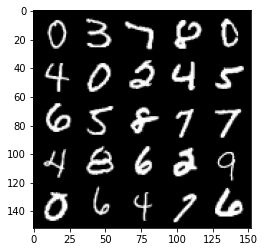

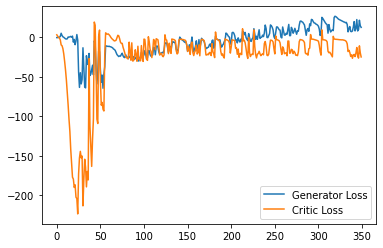

Step 7050: Generator loss: 11.389427995681762, critic loss: -24.184569333076478


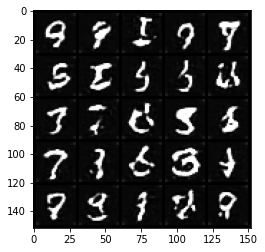

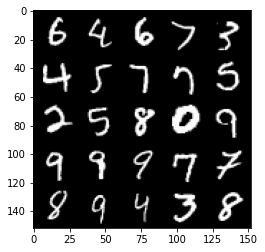

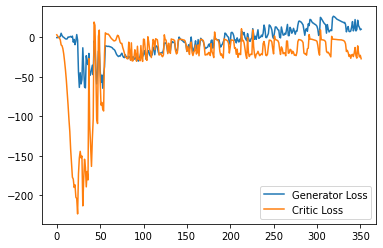

Step 7100: Generator loss: 11.551633803844451, critic loss: -23.0236739153862


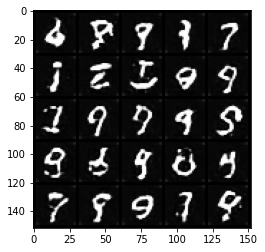

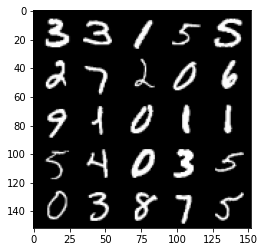

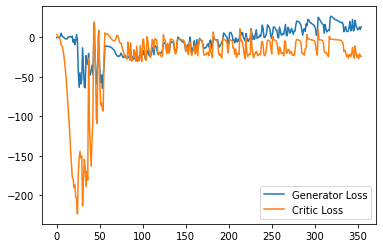

Step 7150: Generator loss: 18.505156798362734, critic loss: -8.084594424009325


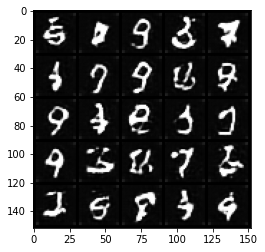

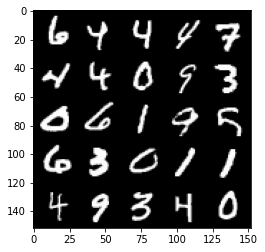

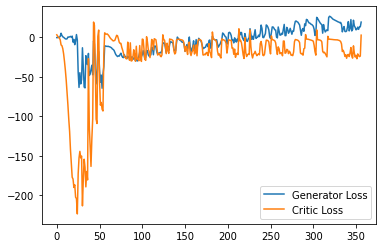

Step 7200: Generator loss: 25.413025360107422, critic loss: -2.9942548370361326


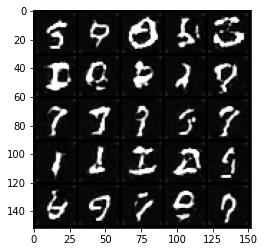

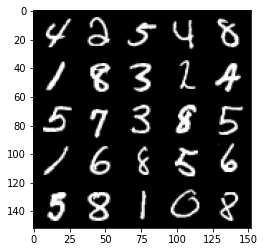

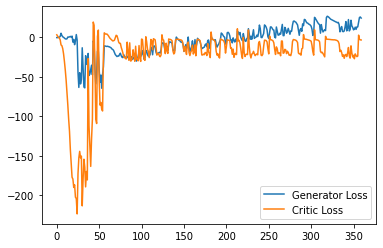

Step 7250: Generator loss: 23.463969917297362, critic loss: -4.626886489868164


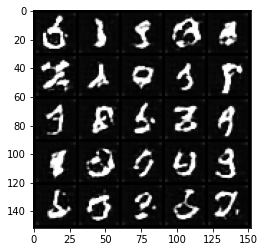

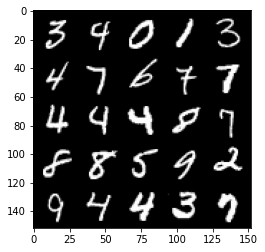

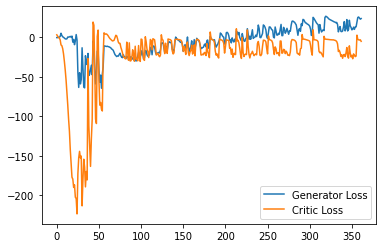

Step 7300: Generator loss: 13.616645359992981, critic loss: -16.57714942026139


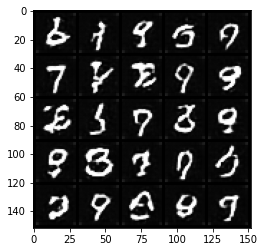

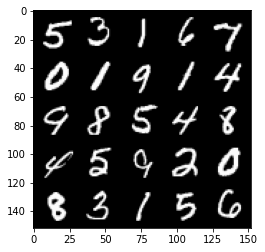

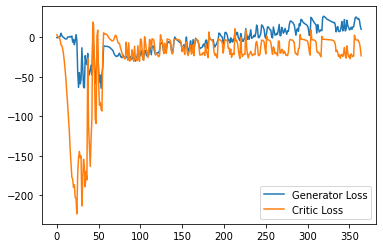

Step 7350: Generator loss: 17.447958030700683, critic loss: -20.522373734474186


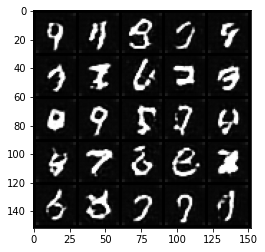

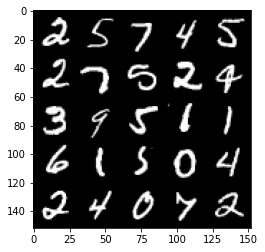

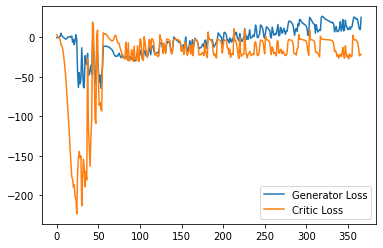

Step 7400: Generator loss: 27.17534384906292, critic loss: -12.07352891254425


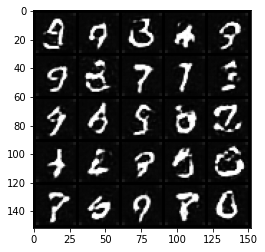

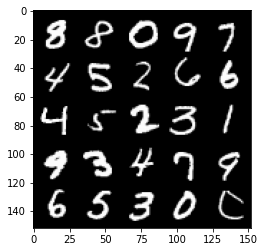

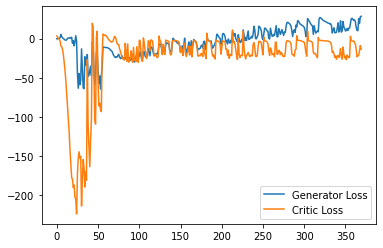

Step 7450: Generator loss: 23.56861380338669, critic loss: -12.30458240795135


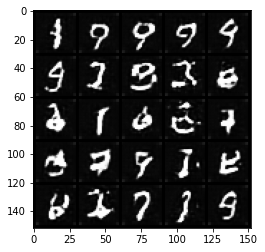

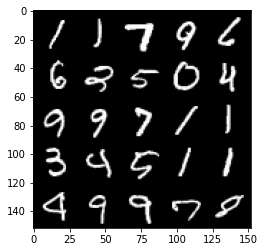

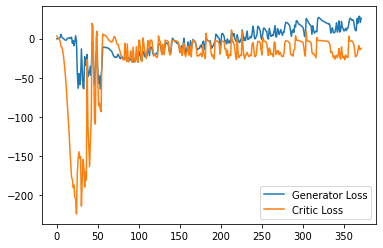

Step 7500: Generator loss: 21.73847029685974, critic loss: -14.663423155307768


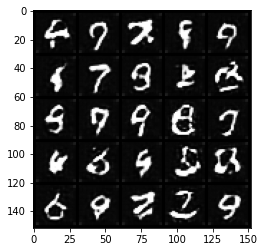

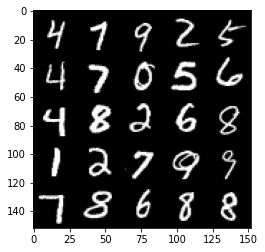

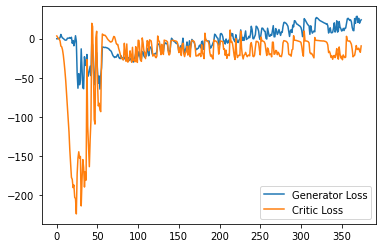

Step 7550: Generator loss: 26.829703602790833, critic loss: -11.687553684234617


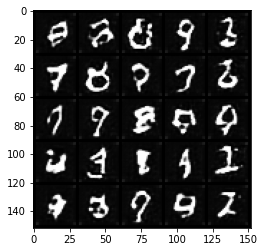

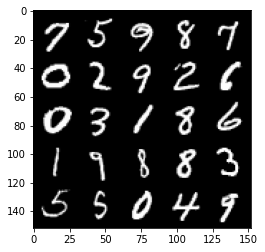

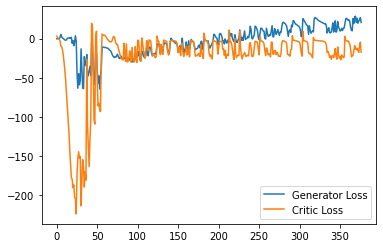

Step 7600: Generator loss: 17.45574152946472, critic loss: -21.72630943226815


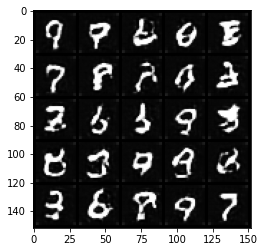

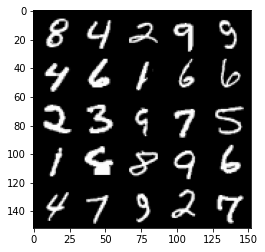

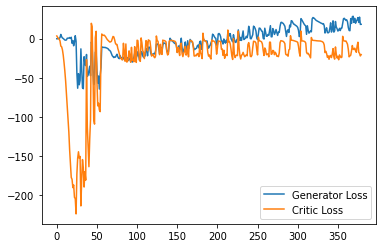

Step 7650: Generator loss: 25.12036642074585, critic loss: -15.857689666748048


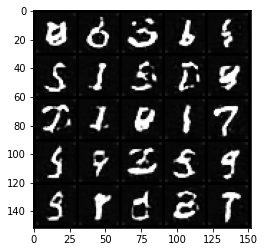

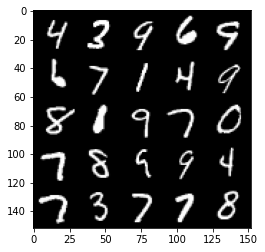

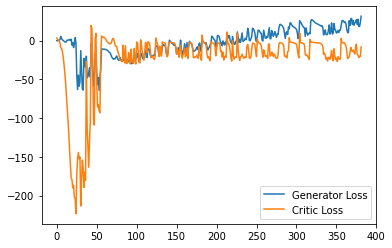

Step 7700: Generator loss: 25.722153539657594, critic loss: -18.55034111118317


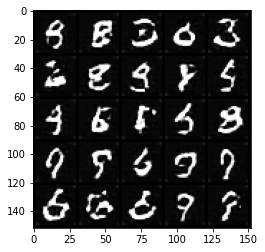

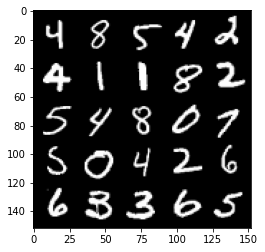

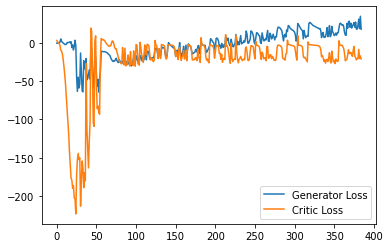

Step 7750: Generator loss: 27.233252668380736, critic loss: -17.73507786273957


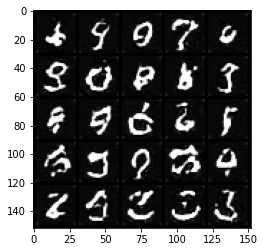

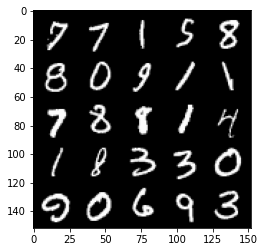

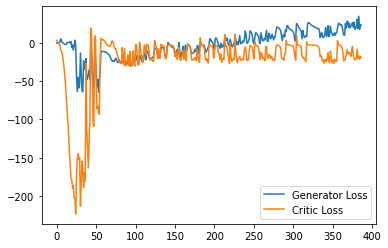

Step 7800: Generator loss: 24.204103784561156, critic loss: -19.31693715643883


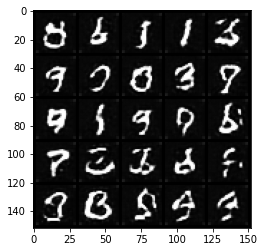

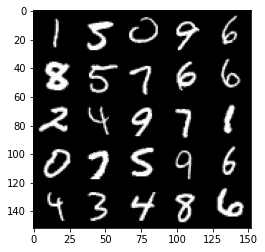

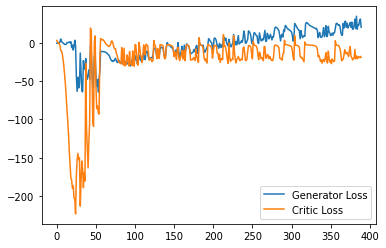

Step 7850: Generator loss: 23.00275418281555, critic loss: -20.451350330352785


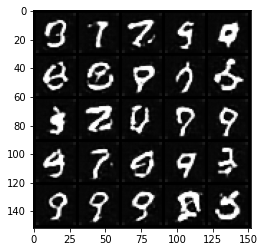

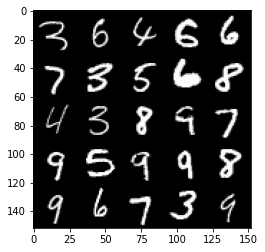

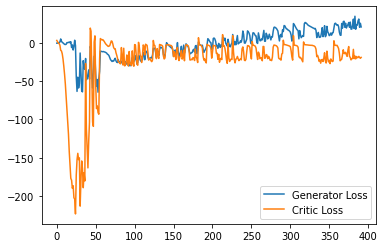

Step 7900: Generator loss: 18.739415469169618, critic loss: -21.946629463195805


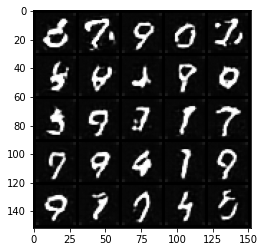

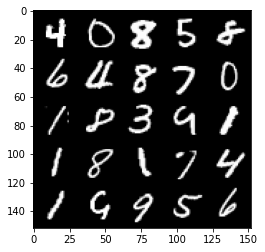

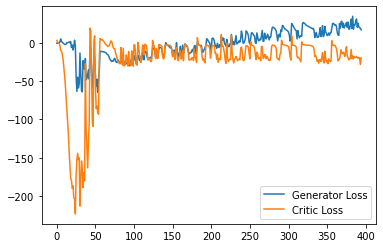

Step 7950: Generator loss: 31.12213936805725, critic loss: -20.2292642660141


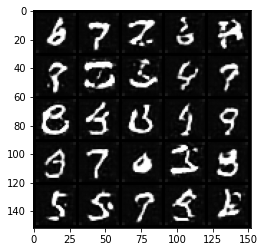

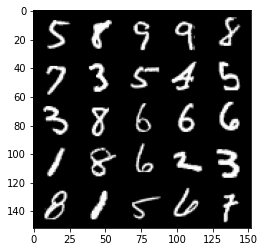

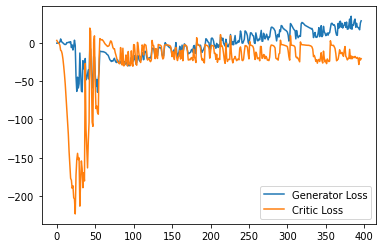

Step 8000: Generator loss: 27.39493230819702, critic loss: -6.720461229801178


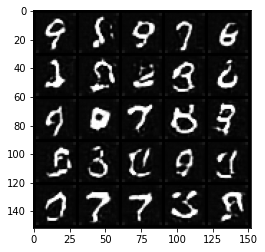

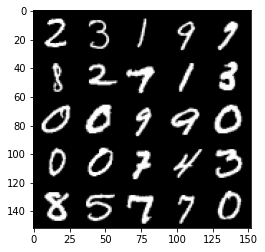

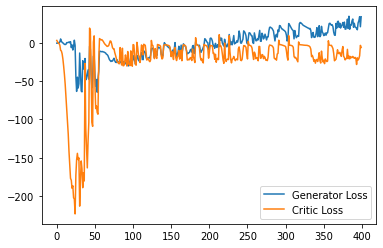

Step 8050: Generator loss: 25.058237781524657, critic loss: -18.949786720752716


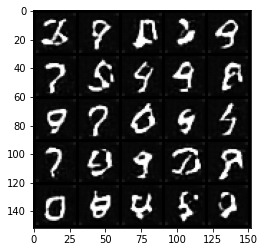

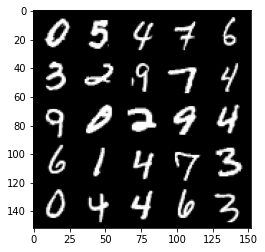

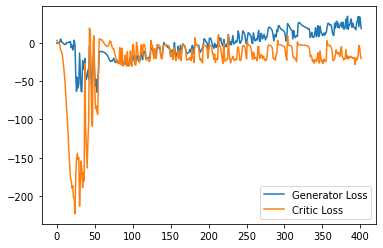

Step 8100: Generator loss: 26.745097866058348, critic loss: -20.51301994276047


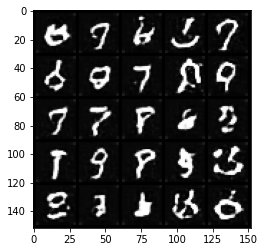

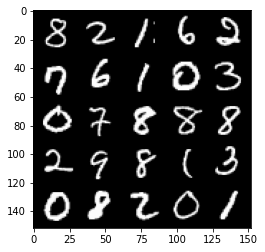

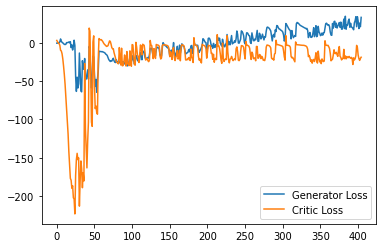

Step 8150: Generator loss: 27.744226570129396, critic loss: -14.886544926166533


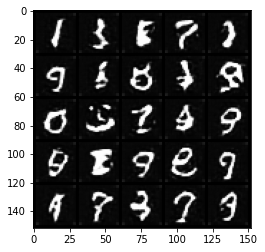

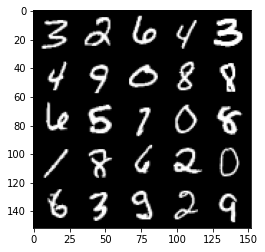

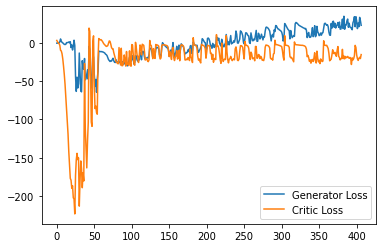

Step 8200: Generator loss: 20.295613117218018, critic loss: -23.792493340492246


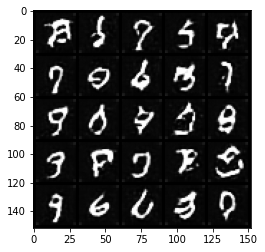

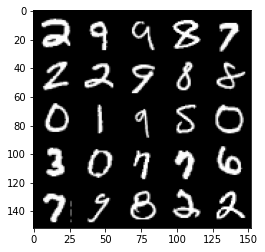

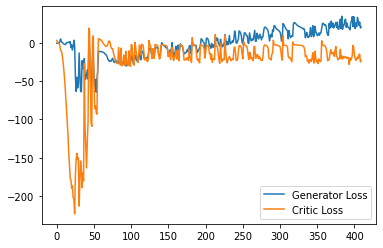

Step 8250: Generator loss: 30.70088186264038, critic loss: -6.892239461421966


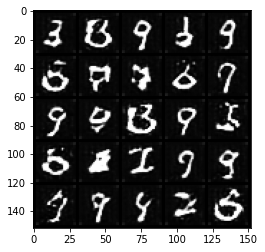

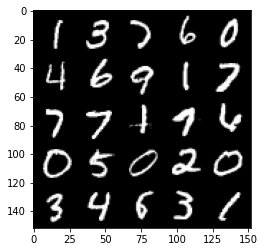

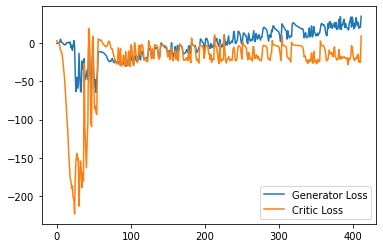

Step 8300: Generator loss: 27.70582530975342, critic loss: -17.063270534515382


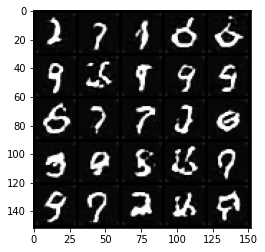

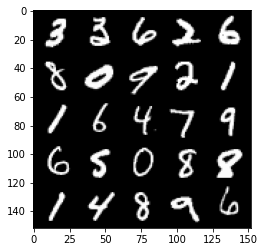

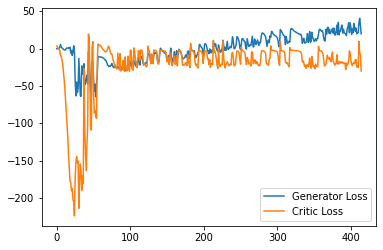

Step 8350: Generator loss: 24.00720754146576, critic loss: -22.256895733833318


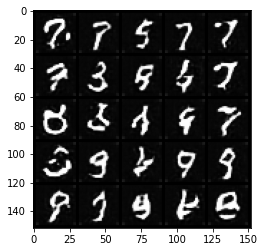

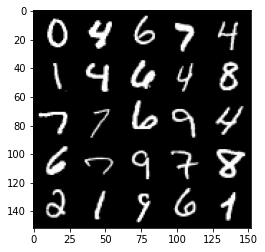

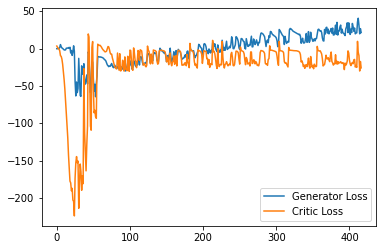

Step 8400: Generator loss: 32.01898170471191, critic loss: -19.251556503295898


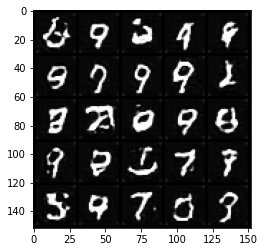

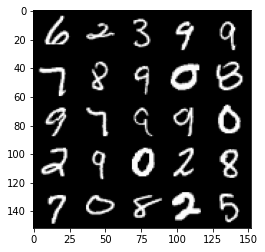

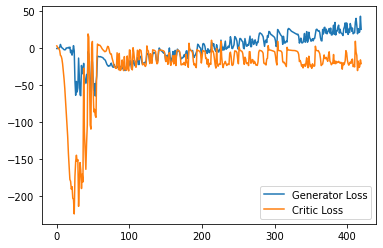

Step 8450: Generator loss: 26.06766399383545, critic loss: -21.350149744987494


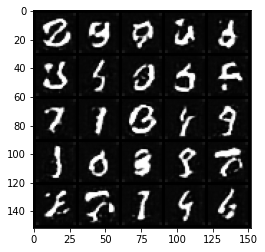

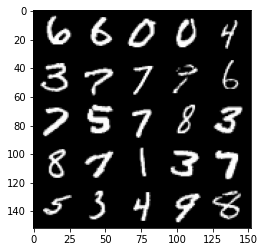

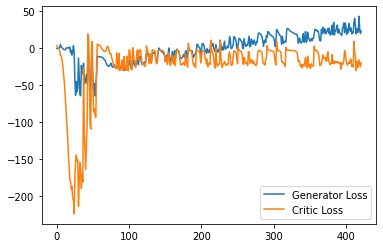

Step 8500: Generator loss: 27.70957721710205, critic loss: -20.19343515205383


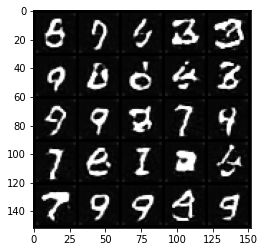

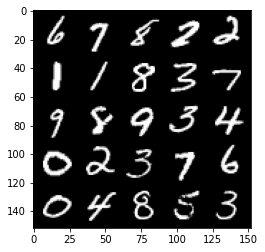

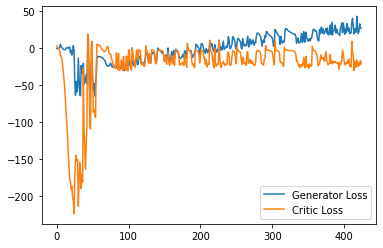

KeyboardInterrupt: 

In [20]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
